In [23]:
!pip install scikit-plot


You should consider upgrading via the '/home/ccs/Notebooks/my_env/bin/python3.6 -m pip install --upgrade pip' command.


In [24]:
import sys
!{sys.executable} -m pip install xgboost

You should consider upgrading via the '/home/ccs/Notebooks/my_env/bin/python3.6 -m pip install --upgrade pip' command.


In [157]:
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.graph_objs as go
import plotly.io as pio

In [25]:
import matplotlib.pyplot as plt
import seaborn as sns
import scikitplot as skplt
import numpy as np
import pandas as pd
from sklearn.preprocessing import scale
from sklearn.metrics import confusion_matrix, recall_score, accuracy_score, precision_score
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier as xgb
import warnings

In [26]:
%matplotlib inline
sns.set_style("darkgrid")
warnings.filterwarnings("ignore")
plt.rc("font", family="serif", size=15)

In [27]:
PdM_errors_url="https://raw.githubusercontent.com/soumya-soman/predictive-maintenance/master/PdM_errors.csv"
 
errors = pd.read_csv(PdM_errors_url)
errors.head(5)
#remove

,datetime,machineID,errorID
0,2015-01-03 07:00:00,1,error1
1,2015-01-03 20:00:00,1,error3
2,2015-01-04 06:00:00,1,error5
3,2015-01-10 15:00:00,1,error4
4,2015-01-22 10:00:00,1,error4


In [28]:
maint=pd.read_csv('/home/ccs/Notebooks/Predictive_Maintanence/maint_mock_test.csv',sep=',')
 
# maint = pd.read_csv(maint_url)
maint.head()


,datetime,machineID,comp
0,2015-01-02 06:00:00,93,comp17
1,2015-01-02 06:00:00,69,comp15
2,2015-01-02 06:00:00,88,comp14
3,2015-01-02 06:00:00,26,comp21
4,2015-01-02 06:00:00,33,comp23


In [133]:
failures=pd.read_csv('/home/ccs/Notebooks/Predictive_Maintanence/failures_mock_test.csv',sep = '\t')
 
# failures = pd.read_csv(failures_url)
failures.head()
#plot pair plot
## if 761 is applicable for all machines
# machines== comp distribution
#create  but delete manually


,datetime,machineID,failure
0,2015-01-02 06:00:00,95,comp14
1,2015-01-02 06:00:00,81,comp12
2,2015-01-02 06:00:00,79,comp11
3,2015-01-02 06:00:00,3,comp4
4,2015-01-02 06:00:00,80,comp24


In [30]:
machines_url="https://raw.githubusercontent.com/soumya-soman/predictive-maintenance/master/PdM_machines.csv"
 
machines = pd.read_csv(machines_url)
machines.head()

,machineID,model,age
0,1,model3,18
1,2,model4,7
2,3,model3,8
3,4,model3,7
4,5,model3,2


In [31]:
telemetry_url="https://raw.githubusercontent.com/soumya-soman/predictive-maintenance/master/PdM_telemetry.csv"
 
telemetry = pd.read_csv(telemetry_url)
telemetry.tail()

,datetime,machineID,volt,rotate,pressure,vibration
968584,2016-01-01 02:00:00,100,179.438162,395.222827,102.290715,50.771941
968585,2016-01-01 03:00:00,100,189.617555,446.207972,98.180607,35.123072
968586,2016-01-01 04:00:00,100,192.483414,447.816524,94.132837,48.314561
968587,2016-01-01 05:00:00,100,165.475310,413.771670,104.081073,44.835259
968588,2016-01-01 06:00:00,100,171.336037,496.096870,79.095538,37.845245


In [32]:
telemetry.head()

,datetime,machineID,volt,rotate,pressure,vibration
0,2015-01-01 06:00:00,1,176.217853,418.504078,113.077935,45.087686
1,2015-01-01 07:00:00,1,162.879223,402.747490,95.460525,43.413973
2,2015-01-01 08:00:00,1,170.989902,527.349825,75.237905,34.178847
3,2015-01-01 09:00:00,1,162.462833,346.149335,109.248561,41.122144
4,2015-01-01 10:00:00,1,157.610021,435.376873,111.886648,25.990511


In [33]:
telemetry.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 968589 entries, 0 to 968588
Data columns (total 6 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   datetime   968589 non-null  object 
 1   machineID  968589 non-null  int64  
 2   volt       968589 non-null  float64
 3   rotate     968589 non-null  float64
 4   pressure   968588 non-null  float64
 5   vibration  968588 non-null  float64
dtypes: float64(4), int64(1), object(1)
memory usage: 44.3+ MB


In [34]:
telemetry.dtypes

datetime      object
machineID      int64
volt         float64
rotate       float64
pressure     float64
vibration    float64
dtype: object

In [35]:
telemetry["machineID"].nunique()

100

In [36]:
telemetry["datetime"] = pd.to_datetime(telemetry["datetime"], format="%Y-%m-%d %H:%M:%S")
telemetry.dtypes

datetime     datetime64[ns]
machineID             int64
volt                float64
rotate              float64
pressure            float64
vibration           float64
dtype: object

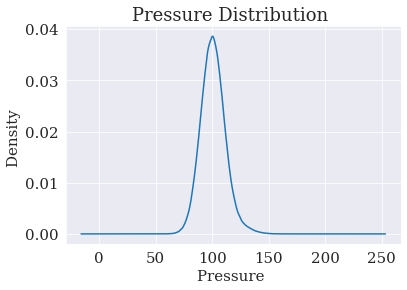

In [37]:
telemetry["pressure"].plot(kind="kde")
plt.title("Pressure Distribution ")
plt.ylabel("Density ")
plt.xlabel("Pressure ")
plt.show()

In [38]:

telemetry.drop_duplicates(keep='first',inplace=True)

In [39]:
maint.drop_duplicates(keep='first',inplace=True)
failures.drop_duplicates(keep='first',inplace=True)

In [40]:
maint.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5780 entries, 0 to 5806
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   datetime   5780 non-null   object
 1   machineID  5780 non-null   int64 
 2   comp       5780 non-null   object
dtypes: int64(1), object(2)
memory usage: 180.6+ KB


In [41]:
remove_n = 2552
drop_indices = np.random.choice(maint.index, remove_n, replace=True)
maint = maint.drop(drop_indices)
maint.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 3742 entries, 0 to 5806
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   datetime   3742 non-null   object
 1   machineID  3742 non-null   int64 
 2   comp       3742 non-null   object
dtypes: int64(1), object(2)
memory usage: 116.9+ KB


In [42]:
failures.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3278 entries, 0 to 3281
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   datetime   3278 non-null   object
 1   machineID  3278 non-null   int64 
 2   failure    3278 non-null   object
dtypes: int64(1), object(2)
memory usage: 102.4+ KB


In [43]:
remove_n = 1952
drop_indices = np.random.choice(failures.index, remove_n, replace=True)
failures = failures.drop(drop_indices)
failures.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1815 entries, 0 to 3281
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   datetime   1815 non-null   object
 1   machineID  1815 non-null   int64 
 2   failure    1815 non-null   object
dtypes: int64(1), object(2)
memory usage: 56.7+ KB


In [44]:
telemetry.describe() 

,machineID,volt,rotate,pressure,vibration
count,876101.000000,876101.000000,876101.000000,876100.000000,876100.000000
mean,50.499955,170.777762,446.605132,100.858668,40.385007
std,28.866101,15.509124,52.673857,11.048679,5.370361
min,1.000000,97.333604,138.432075,51.237106,14.877054
25%,25.000000,160.304961,412.305749,93.498181,36.777299
50%,50.000000,170.607343,447.558205,100.425559,40.237247
75%,75.000000,181.004499,482.176586,107.555231,43.784938
max,100.000000,255.124717,695.020984,185.951998,76.791072


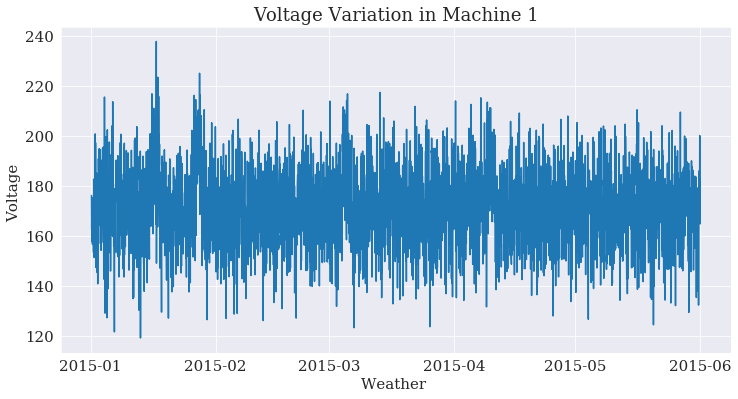

In [45]:
# We show an example graph of the voltage values ​​for machine 1 during the first 6 months of 2015.

plot_df = telemetry.loc[
    (telemetry["machineID"] == 1)
    & (telemetry["datetime"] > pd.to_datetime("2015-01-01"))
    & (telemetry["datetime"] < pd.to_datetime("2015-06-01")), ["datetime", "volt"]
]

plt.figure(figsize=(12, 6))
plt.plot(plot_df["datetime"], plot_df["volt"])
plt.title("Voltage Variation in Machine 1")
plt.ylabel("Voltage ")

# We make labels legible.
adf = plt.gca().get_xaxis().get_major_formatter()
adf.scaled[1.0] = "%m-%d"
plt.xlabel("Weather ")
plt.show()

In [46]:
##ERROR DATA ANALYSIS
errors.head()

,datetime,machineID,errorID
0,2015-01-03 07:00:00,1,error1
1,2015-01-03 20:00:00,1,error3
2,2015-01-04 06:00:00,1,error5
3,2015-01-10 15:00:00,1,error4
4,2015-01-22 10:00:00,1,error4


In [47]:
errors.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3919 entries, 0 to 3918
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   datetime   3919 non-null   object
 1   machineID  3919 non-null   int64 
 2   errorID    3919 non-null   object
dtypes: int64(1), object(2)
memory usage: 92.0+ KB


In [48]:
# Formatting the date and time field that comes as a string.
# Categories allow comparison between values, automatic ordering, easier graphing and other functions.
# Also less memory (similar to "factor" in R).
errors["datetime"] = pd.to_datetime(errors["datetime"], format="%Y-%m-%d %H:%M:%S")
errors["errorID"] = errors["errorID"].astype("category")

errors.head()

,datetime,machineID,errorID
0,2015-01-03 07:00:00,1,error1
1,2015-01-03 20:00:00,1,error3
2,2015-01-04 06:00:00,1,error5
3,2015-01-10 15:00:00,1,error4
4,2015-01-22 10:00:00,1,error4


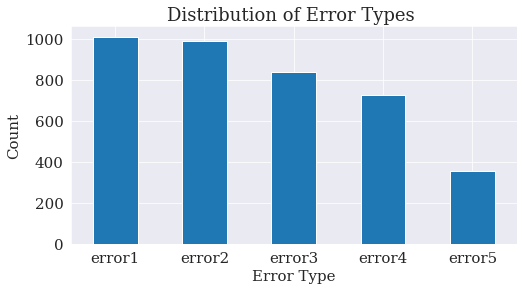

In [49]:
#sns.set_style("darkgrid")
plt.figure(figsize=(8, 4))
errors["errorID"].value_counts().plot(kind="bar", rot=0)
plt.title("Distribution of Error Types ")
plt.ylabel("Count")
plt.xlabel("Error Type")
plt.show()

In [50]:
## MAINT DATA ANALYSIS
maint.head()

,datetime,machineID,comp
0,2015-01-02 06:00:00,93,comp17
2,2015-01-02 06:00:00,88,comp14
4,2015-01-02 06:00:00,33,comp23
5,2015-01-02 06:00:00,43,comp2
13,2015-01-04 06:00:00,27,comp16


In [51]:
maint.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3742 entries, 0 to 5806
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   datetime   3742 non-null   object
 1   machineID  3742 non-null   int64 
 2   comp       3742 non-null   object
dtypes: int64(1), object(2)
memory usage: 116.9+ KB


In [52]:
# Formatting the date and time field that comes as a string.
maint["datetime"] = pd.to_datetime(maint["datetime"], format="%Y-%m-%d %H:%M:%S")
maint["comp"] = maint["comp"].astype("category")
maint.dtypes

datetime     datetime64[ns]
machineID             int64
comp               category
dtype: object

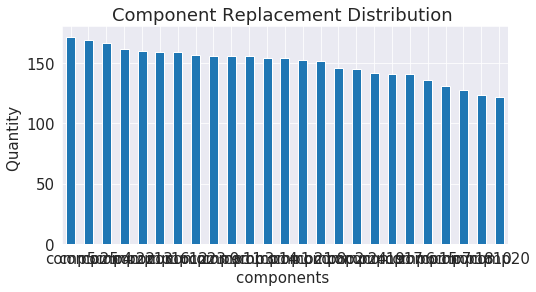

In [53]:
sns.set_style("darkgrid")
plt.figure(figsize=(8, 4))
maint["comp"].value_counts().plot(kind="bar", rot=0)
plt.title("Component Replacement Distribution ")
plt.ylabel("Quantity ")
plt.xlabel("components ")
plt.show()

In [54]:
##Machines data analysis
machines.head()

,machineID,model,age
0,1,model3,18
1,2,model4,7
2,3,model3,8
3,4,model3,7
4,5,model3,2


In [55]:
machines.shape
machines.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   machineID  100 non-null    int64 
 1   model      100 non-null    object
 2   age        100 non-null    int64 
dtypes: int64(2), object(1)
memory usage: 2.5+ KB


In [56]:
machines.dtypes

machineID     int64
model        object
age           int64
dtype: object

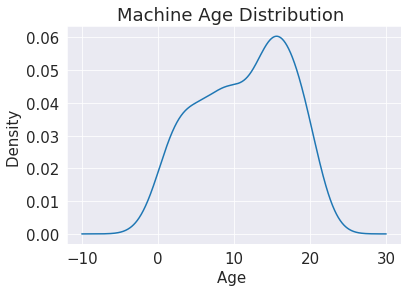

In [57]:
# We check if there are several hills as it can suggest two different groups.
machines["age"].plot(kind="kde")
plt.title("Machine Age Distribution ")
plt.xlabel("Age ")
plt.ylabel("Density ")
plt.show()

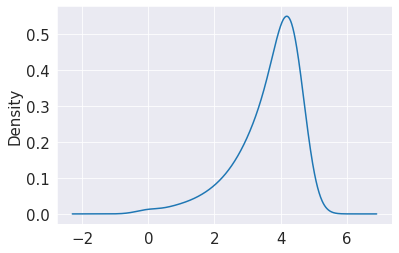

In [58]:
# We apply natural logarithm to normalize.
np.log(machines[machines["age"] != 0].iloc[:, 0]).plot(kind="kde")
plt.show()

In [59]:
machines["model"] = machines["model"].astype("category")
machines.dtypes

machineID       int64
model        category
age             int64
dtype: object

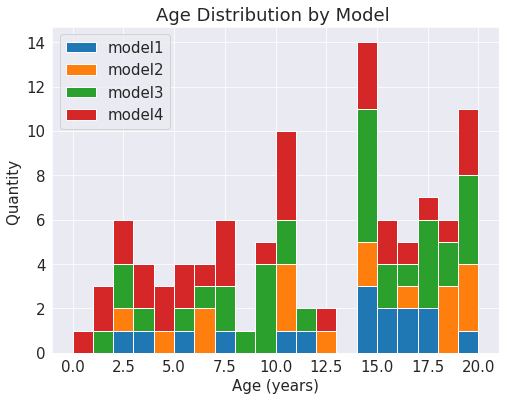

In [60]:
plt.figure(figsize=(8, 6))
_, bins, _ = plt.hist([
    machines.loc[machines["model"] == "model1", "age"],
    machines.loc[machines["model"] == "model2", "age"],
    machines.loc[machines["model"] == "model3", "age"],
    machines.loc[machines["model"] == "model4", "age"]],
    20, stacked=True, label=["model1", "model2", "model3", "model4"
])
plt.title("Age Distribution by Model ")
plt.xlabel("Age (years)")
plt.ylabel("Quantity ")
plt.legend()
plt.show()

In [61]:
## Failures data analysis
failures.head()

,datetime,machineID,failure
0,2015-01-02 06:00:00,95,comp14
1,2015-01-02 06:00:00,81,comp12
4,2015-01-02 06:00:00,80,comp24
5,2015-01-02 06:00:00,14,comp24
7,2015-01-04 06:00:00,41,comp3


In [62]:
failures.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1815 entries, 0 to 3281
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   datetime   1815 non-null   object
 1   machineID  1815 non-null   int64 
 2   failure    1815 non-null   object
dtypes: int64(1), object(2)
memory usage: 56.7+ KB


In [63]:
# We format the datetime that comes as a string
failures["datetime"] = pd.to_datetime(failures["datetime"], format="%Y-%m-%d %H:%M:%S")
failures["failure"] = failures["failure"].astype("category")
failures.dtypes

datetime     datetime64[ns]
machineID             int64
failure            category
dtype: object

In [64]:
failures.describe(include="all")

,datetime,machineID,failure
count,1815,1815.000000,1815
unique,303,NaN,25
top,2015-01-31 06:00:00,NaN,comp8
freq,13,NaN,95
first,2015-01-02 06:00:00,NaN,NaN
last,2015-12-31 06:00:00,NaN,NaN
mean,NaN,50.687052,NaN
std,NaN,28.538010,NaN
min,NaN,0.000000,NaN
25%,NaN,26.000000,NaN


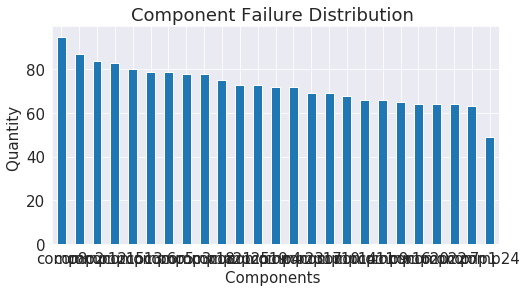

In [65]:
plt.figure(figsize=(8, 4))
failures["failure"].value_counts().plot(kind="bar", rot=0)
plt.title("Component Failure Distribution ")
plt.ylabel("Quantity ")
plt.xlabel("Components ")
plt.show()

In [66]:
# We calculate average values ​​for telemetry characteristics
# we pivot because we need the datetime as an index for "resample" to work
# resample creates the lagging
# closed = 'right' => (6:00, 9:00] or 6:00 < x <= 9:00
# closed='left'  => [6:00, 9:00) or 6:00 <= x < 9:00
# it can't be both
# unstack: return df to original format
# we have 100 machines, 4 sensors = 400 columns
# unstack shows a dataseries in the columns as an index and returns series (if there are several indexes they are rearranged).
# Each dataframe in temp has the values ​​of the field that corresponds to it at that moment.

temp = []
fields = ["volt", "rotate", "pressure", "vibration"]
temp = [
    pd.pivot_table(
        telemetry,
        index="datetime",
        columns="machineID",
        values=col).resample("3H", closed="left", label="right").mean().unstack()
    for col in fields
]
temp[1].head()

machineID  datetime           
1          2015-01-01 09:00:00    449.533798
           2015-01-01 12:00:00    403.949857
           2015-01-01 15:00:00    435.781707
           2015-01-01 18:00:00    430.472823
           2015-01-01 21:00:00    437.111120
dtype: float64

In [67]:
temp

[machineID  datetime           
 1          2015-01-01 09:00:00    170.028993
            2015-01-01 12:00:00    164.192565
            2015-01-01 15:00:00    168.134445
            2015-01-01 18:00:00    165.514453
            2015-01-01 21:00:00    168.809347
                                      ...    
 100        2015-12-31 21:00:00    166.078945
            2016-01-01 00:00:00    158.327984
            2016-01-01 03:00:00    170.306956
            2016-01-01 06:00:00    182.525427
            2016-01-01 09:00:00    171.336037
 Length: 292100, dtype: float64,
 machineID  datetime           
 1          2015-01-01 09:00:00    449.533798
            2015-01-01 12:00:00    403.949857
            2015-01-01 15:00:00    435.781707
            2015-01-01 18:00:00    430.472823
            2015-01-01 21:00:00    437.111120
                                      ...    
 100        2015-12-31 21:00:00    424.431184
            2016-01-01 00:00:00    504.056262
            2016-01-01 03:00:

In [68]:
telemetry.sample()

,datetime,machineID,volt,rotate,pressure,vibration
867306,2015-06-10 15:00:00,89,171.374023,483.955785,85.618643,35.949247


In [69]:
telemetry_mean_3h = pd.concat(temp, axis=1) # We unite the series.
telemetry_mean_3h.columns = [col + "mean_3h" for col in fields] # We assign column names.
telemetry_mean_3h.reset_index(inplace=True) # We flatten the frame.
telemetry_mean_3h.head()

,machineID,datetime,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h
0,1,2015-01-01 09:00:00,170.028993,449.533798,94.592122,40.893502
1,1,2015-01-01 12:00:00,164.192565,403.949857,105.687417,34.255891
2,1,2015-01-01 15:00:00,168.134445,435.781707,107.793709,41.239405
3,1,2015-01-01 18:00:00,165.514453,430.472823,101.703289,40.373739
4,1,2015-01-01 21:00:00,168.809347,437.111120,90.911060,41.738542


In [70]:
# We repeat for the standard deviation.
temp = [
    pd.pivot_table(
        telemetry,
        index="datetime",
        columns="machineID",
        values=col).resample("3H", closed="left", label="right").std().unstack()
    for col in fields
]
temp[0].head()

machineID  datetime           
1          2015-01-01 09:00:00     6.721032
           2015-01-01 12:00:00     7.596570
           2015-01-01 15:00:00    10.124584
           2015-01-01 18:00:00     4.673269
           2015-01-01 21:00:00    14.752132
dtype: float64

In [71]:
telemetry_sd_3h = pd.concat(temp, axis=1)
telemetry_sd_3h.columns = [i + "sd_3h" for i in fields]
telemetry_sd_3h.reset_index(inplace=True)
telemetry_sd_3h.head()

,machineID,datetime,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h
0,1,2015-01-01 09:00:00,6.721032,67.849599,18.934956,5.874970
1,1,2015-01-01 12:00:00,7.596570,50.120452,8.555032,7.662229
2,1,2015-01-01 15:00:00,10.124584,55.084734,5.909721,5.169304
3,1,2015-01-01 18:00:00,4.673269,42.047278,4.554047,2.106108
4,1,2015-01-01 21:00:00,14.752132,47.048609,4.244158,2.207884


In [72]:
# To capture a longer-term effect, the 24-hour lagging functions are also calculated.
# We create new values ​​with 24-hour averages, and then select the first result every 3 hours.
# In this way we can join the results with the previous lagging characteristics (calculated at 3 hours).

temp = []
fields = ["volt", "rotate", "pressure", "vibration"]

temp = [
    pd.pivot_table(
        telemetry,
        index="datetime",
        columns="machineID",
        values=col).rolling(window=24).mean().resample("3H", closed="left", label="right").first().unstack()
    for col in fields
]
temp[0].head()

machineID  datetime           
1          2015-01-01 09:00:00   NaN
           2015-01-01 12:00:00   NaN
           2015-01-01 15:00:00   NaN
           2015-01-01 18:00:00   NaN
           2015-01-01 21:00:00   NaN
dtype: float64

In [73]:
telemetry_mean_24h = pd.concat(temp, axis=1)
telemetry_mean_24h.columns = [i + "mean_24h" for i in fields]
telemetry_mean_24h.reset_index(inplace=True)
# Due to the moving average method, the first 23 records are null; you have to eliminate them.
# It does not happen at the end of the frame because rolling stops at the end.
# We end up with a frame of less data than the original telemetry as well as the previous 3H.
telemetry_mean_24h = telemetry_mean_24h.loc[-telemetry_mean_24h["voltmean_24h"].isnull()]
telemetry_mean_24h.head()

,machineID,datetime,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h
7,1,2015-01-02 06:00:00,169.733809,445.179865,96.797113,40.385160
8,1,2015-01-02 09:00:00,170.614862,446.364859,96.849785,39.736826
9,1,2015-01-02 12:00:00,169.893965,447.009407,97.715600,39.498374
10,1,2015-01-02 15:00:00,171.243444,444.233563,96.666060,40.229370
11,1,2015-01-02 18:00:00,170.792486,448.440437,95.766838,40.055214


In [74]:
# We repeat for the standard deviation
temp = []
fields = ["volt", "rotate", "pressure", "vibration"]

temp = [
    pd.pivot_table(
        telemetry,
        index="datetime",
        columns="machineID",
        values=col).rolling(window=24).std().resample("3H", closed="left", label="right").first().unstack(level=-1)
    for col in fields
]
temp[0].head()

machineID  datetime           
1          2015-01-01 09:00:00   NaN
           2015-01-01 12:00:00   NaN
           2015-01-01 15:00:00   NaN
           2015-01-01 18:00:00   NaN
           2015-01-01 21:00:00   NaN
dtype: float64

In [75]:
telemetry_sd_24h = pd.concat(temp, axis=1)
telemetry_sd_24h.columns = [i + "sd_24h" for i in fields]
telemetry_sd_24h.reset_index(inplace=True)
telemetry_sd_24h = telemetry_sd_24h.loc[-telemetry_sd_24h["voltsd_24h"].isnull()]
telemetry_sd_24h.head(10)

,machineID,datetime,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h
7,1,2015-01-02 06:00:00,11.233120,48.717395,10.079880,5.853209
8,1,2015-01-02 09:00:00,12.519402,48.385076,10.171540,6.163231
9,1,2015-01-02 12:00:00,13.370357,42.432317,9.471669,6.195076
10,1,2015-01-02 15:00:00,13.299281,41.346121,8.731229,5.687944
11,1,2015-01-02 18:00:00,13.954518,43.490234,8.061653,5.898069
12,1,2015-01-02 21:00:00,14.402740,42.626186,10.408012,5.941890
13,1,2015-01-03 00:00:00,15.513819,40.395881,10.833294,5.737671
14,1,2015-01-03 03:00:00,15.726970,39.648116,11.904700,5.601191
15,1,2015-01-03 06:00:00,15.635083,41.828592,11.326412,5.583521
16,1,2015-01-03 09:00:00,13.995465,40.843882,11.036546,5.561553


In [76]:
# We combine the features created so far.
# We take the values ​​2: 6 to avoid duplicate IDs and dates.
# axis = 0 we move in the direction of the rows, axis = 1, we move in the direction of the columns.
telemetry_feat = pd.concat([
    telemetry_mean_3h,
    telemetry_sd_3h.iloc[:, 2:6],
    telemetry_mean_24h.iloc[:, 2:6],
    telemetry_sd_24h.iloc[:, 2:6]], axis=1).dropna()
telemetry_feat.head()

,machineID,datetime,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h
7,1,2015-01-02 06:00:00,180.133784,440.608320,94.137969,41.551544,21.322735,48.770512,2.135684,10.037208,169.733809,445.179865,96.797113,40.385160,11.233120,48.717395,10.079880,5.853209
8,1,2015-01-02 09:00:00,176.364293,439.349655,101.553209,36.105580,18.952210,51.329636,13.789279,6.737739,170.614862,446.364859,96.849785,39.736826,12.519402,48.385076,10.171540,6.163231
9,1,2015-01-02 12:00:00,160.384568,424.385316,99.598722,36.094637,13.047080,13.702496,9.988609,1.639962,169.893965,447.009407,97.715600,39.498374,13.370357,42.432317,9.471669,6.195076
10,1,2015-01-02 15:00:00,170.472461,442.933997,102.380586,40.483002,16.642354,56.290447,3.305739,8.854145,171.243444,444.233563,96.666060,40.229370,13.299281,41.346121,8.731229,5.687944
11,1,2015-01-02 18:00:00,163.263806,468.937558,102.726648,40.921802,17.424688,38.680380,9.105775,3.060781,170.792486,448.440437,95.766838,40.055214,13.954518,43.490234,8.061653,5.898069


In [77]:
telemetry_feat.describe()

,machineID,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h
count,291300.00000,291300.000000,291300.000000,291300.000000,291300.000000,291300.000000,291300.000000,291300.000000,291300.000000,291300.000000,291300.000000,291300.000000,291300.000000,291300.000000,291300.000000,291300.000000,291300.000000
mean,50.50000,170.771416,446.612972,100.855301,40.384328,13.299858,44.456335,8.885822,4.440660,170.772579,446.613440,100.854547,40.384564,14.918849,49.947916,10.046687,5.002065
std,28.86612,9.497201,33.122865,7.408854,3.476641,6.966647,23.216421,4.656341,2.320066,4.716970,18.074248,4.733098,2.059861,2.260726,7.682126,1.713726,0.799820
min,1.00000,125.532506,211.811184,72.118639,26.569635,0.025509,0.078991,0.027417,0.015278,155.812721,266.010419,91.057429,35.060087,6.380619,18.385248,4.145308,2.144863
25%,25.75000,164.445576,427.568132,96.238173,38.147839,8.027455,26.903567,5.370647,2.684308,168.070890,441.549802,98.668589,39.354062,13.358663,44.668824,8.924317,4.460347
50%,50.50000,170.430790,448.385564,100.233139,40.146085,12.495595,41.795700,8.345785,4.173854,170.210913,449.212554,100.097694,40.072752,14.853948,49.613807,9.921407,4.958594
75%,75.25000,176.607051,468.447680,104.404520,42.227392,17.689118,59.103715,11.789645,5.898997,172.459612,456.368008,101.611121,40.833364,16.394764,54.821318,10.980498,5.484480
max,100.00000,241.420717,586.682904,162.309656,69.311324,58.444332,179.903039,35.659369,18.305595,220.782618,499.096975,152.310351,61.932124,27.664538,103.819404,28.654103,12.325783


In [78]:
##Characteristics Lag in Errors
"""
We start by reformatting the error data to have one input per machine per time
when at least one error occurred.
We create a column for each type of error.
"""
error_count = pd.get_dummies(errors) # We put a 1 if the error appears for that machine, 0 otherwise.
error_count.columns = ["datetime", "machineID", "error1", "error2", "error3", "error4", "error5"]
error_count.head(15)

,datetime,machineID,error1,error2,error3,error4,error5
0,2015-01-03 07:00:00,1,1,0,0,0,0
1,2015-01-03 20:00:00,1,0,0,1,0,0
2,2015-01-04 06:00:00,1,0,0,0,0,1
3,2015-01-10 15:00:00,1,0,0,0,1,0
4,2015-01-22 10:00:00,1,0,0,0,1,0
5,2015-01-25 15:00:00,1,0,0,0,1,0
6,2015-01-27 04:00:00,1,1,0,0,0,0
7,2015-03-03 22:00:00,1,0,1,0,0,0
8,2015-03-05 06:00:00,1,1,0,0,0,0
9,2015-03-20 18:00:00,1,1,0,0,0,0


In [79]:
"""
The dates in the dataframe are repeated, so we group by date.
We combine errors for a given machine at a specific time.
We do sum in case there are multiple errors of the same type at the same time, but not expected.
"""
error_count_grouped = error_count.groupby(["machineID", "datetime"]).sum().reset_index()
error_count_grouped.head(5)

,machineID,datetime,error1,error2,error3,error4,error5
0,1,2015-01-03 07:00:00,1,0,0,0,0
1,1,2015-01-03 20:00:00,0,0,1,0,0
2,1,2015-01-04 06:00:00,0,0,0,0,1
3,1,2015-01-10 15:00:00,0,0,0,1,0
4,1,2015-01-22 10:00:00,0,0,0,1,0


In [80]:
"""
We check that the registered errors exist in the available machines filled with 0
the non-matches so we only search for a match with datetime and machineID.
"""
error_count_filtered = telemetry[["datetime", "machineID"]].merge(
    error_count_grouped,
    on=["machineID", "datetime"],
    how="left"
).fillna(0.0)

error_count_filtered.sample(50)

,datetime,machineID,error1,error2,error3,error4,error5
490567,2015-12-30 05:00:00,56,0.0,0.0,0.0,0.0,0.0
210639,2015-01-16 20:00:00,25,0.0,0.0,0.0,0.0,0.0
136222,2015-07-20 12:00:00,16,0.0,0.0,0.0,0.0,0.0
629556,2015-11-10 18:00:00,72,0.0,0.0,0.0,0.0,0.0
121227,2015-11-02 19:00:00,14,0.0,0.0,0.0,0.0,0.0
662929,2015-09-02 03:00:00,76,0.0,0.0,0.0,0.0,0.0
52239,2015-12-18 16:00:00,6,0.0,0.0,0.0,0.0,0.0
460061,2015-07-07 06:00:00,53,0.0,0.0,0.0,0.0,0.0
792131,2015-06-01 22:00:00,91,0.0,0.0,0.0,0.0,0.0
454956,2015-12-06 14:00:00,52,0.0,0.0,0.0,0.0,0.0


In [81]:
# We check that there are no anomalies.
error_count_filtered.describe()

,machineID,error1,error2,error3,error4,error5
count,876101.000000,876101.000000,876101.000000,876101.000000,876101.000000,876101.000000
mean,50.499955,0.001153,0.001128,0.000957,0.000830,0.000406
std,28.866101,0.033934,0.033563,0.030913,0.028795,0.020154
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,50.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,75.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,100.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [82]:
# We calculate the total number of errors for each type of error during 24-hour periods. 
# We will take points every 3 hours.

temp = []
fields = [
    "error%d" % i
    for i in range(1,6)
]

temp = [
    pd.pivot_table(
        error_count_filtered,
        index="datetime",
        columns="machineID",
        values=col).rolling(window=24).sum().resample("3H", closed="left", label="right").first().unstack()
    for col in fields
]
temp[0].head(10)

machineID  datetime           
1          2015-01-01 09:00:00    NaN
           2015-01-01 12:00:00    NaN
           2015-01-01 15:00:00    NaN
           2015-01-01 18:00:00    NaN
           2015-01-01 21:00:00    NaN
           2015-01-02 00:00:00    NaN
           2015-01-02 03:00:00    NaN
           2015-01-02 06:00:00    0.0
           2015-01-02 09:00:00    0.0
           2015-01-02 12:00:00    0.0
dtype: float64

In [83]:
error_count_total = pd.concat(temp, axis=1)
error_count_total.columns = [i + "count" for i in fields]
error_count_total.reset_index(inplace=True)
error_count_total = error_count_total.dropna()
error_count_total.head()

,machineID,datetime,error1count,error2count,error3count,error4count,error5count
7,1,2015-01-02 06:00:00,0.0,0.0,0.0,0.0,0.0
8,1,2015-01-02 09:00:00,0.0,0.0,0.0,0.0,0.0
9,1,2015-01-02 12:00:00,0.0,0.0,0.0,0.0,0.0
10,1,2015-01-02 15:00:00,0.0,0.0,0.0,0.0,0.0
11,1,2015-01-02 18:00:00,0.0,0.0,0.0,0.0,0.0


In [84]:
error_count_total["error5count"].unique()

array([0., 1., 2.])

In [85]:
error_count_total.describe()

,machineID,error1count,error2count,error3count,error4count,error5count
count,291400.00000,291400.000000,291400.000000,291400.000000,291400.000000,291400.000000
mean,50.50000,0.027649,0.027069,0.022907,0.019904,0.009753
std,28.86612,0.166273,0.164429,0.151453,0.140820,0.098797
min,1.00000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,25.75000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,50.50000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,75.25000,0.000000,0.000000,0.000000,0.000000,0.000000
max,100.00000,2.000000,2.000000,2.000000,2.000000,2.000000


In [86]:
#Time since Last Maintenance Replacement
maint.head()

,datetime,machineID,comp
0,2015-01-02 06:00:00,93,comp17
2,2015-01-02 06:00:00,88,comp14
4,2015-01-02 06:00:00,33,comp23
5,2015-01-02 06:00:00,43,comp2
13,2015-01-04 06:00:00,27,comp16


In [87]:
#### discus #####
# we create a column for each type of error
pd.set_option('display.max_columns', 5000)
pd.set_option('display.max_rows', 5000)
comp_rep = pd.get_dummies(maint)
comp_rep.columns = ["datetime", "machineID", "comp1",
"comp2",
"comp3",
"comp4",
"comp5",
"comp6",
"comp7",
"comp8",
"comp9",
"comp10",
"comp11",
"comp12",
"comp13",
"comp14",
"comp15",
"comp16",
"comp17",
"comp18",
"comp19",
"comp20",
"comp21",
"comp22",
"comp23",
"comp24",
"comp25"]
comp_rep.head(100)
# comp_rep['machineID'].value_counts()

,datetime,machineID,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25
0,2015-01-02 06:00:00,93,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,2015-01-02 06:00:00,88,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,2015-01-02 06:00:00,33,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
5,2015-01-02 06:00:00,43,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
13,2015-01-04 06:00:00,27,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
15,2015-01-04 06:00:00,28,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
16,2015-01-04 06:00:00,15,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
17,2015-01-04 06:00:00,57,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
18,2015-01-04 06:00:00,36,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
19,2015-01-04 06:00:00,87,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [88]:
#   
# If we don't group by date we can see another perspective.
# We find which components fail together, since we group by date.
comp_rep = comp_rep.groupby(["machineID", "datetime"]).sum().reset_index()
comp_rep.head(50)

,machineID,datetime,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25
0,1,2015-01-15 06:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
1,1,2015-01-31 06:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
2,1,2015-02-02 06:00:00,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,1,2015-02-03 06:00:00,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,1,2015-02-05 06:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
5,1,2015-02-07 06:00:00,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,1,2015-02-22 06:00:00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,1,2015-03-22 06:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
8,1,2015-03-29 06:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
9,1,2015-03-31 06:00:00,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [89]:

# N = 72
# telemetry = telemetry.iloc[N: , :]
telemetry.head()

,datetime,machineID,volt,rotate,pressure,vibration
0,2015-01-01 06:00:00,1,176.217853,418.504078,113.077935,45.087686
1,2015-01-01 07:00:00,1,162.879223,402.747490,95.460525,43.413973
2,2015-01-01 08:00:00,1,170.989902,527.349825,75.237905,34.178847
3,2015-01-01 09:00:00,1,162.462833,346.149335,109.248561,41.122144
4,2015-01-01 10:00:00,1,157.610021,435.376873,111.886648,25.990511


In [90]:
# you have to add the times where there were no replacements
comp_rep = telemetry[["datetime", "machineID"]].merge(
    comp_rep,
    on=["datetime", "machineID"],
    how="outer").fillna(0).sort_values(by=["machineID", "datetime"]
)
comp_rep.head(500)

,datetime,machineID,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25
0,2015-01-01 06:00:00,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2015-01-01 07:00:00,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2015-01-01 08:00:00,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2015-01-01 09:00:00,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2015-01-01 10:00:00,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,2015-01-01 11:00:00,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,2015-01-01 12:00:00,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,2015-01-01 13:00:00,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,2015-01-01 14:00:00,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,2015-01-01 15:00:00,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [91]:
components = ["comp1",
"comp2",
"comp3",
"comp4",
"comp5",
"comp6",
"comp7",
"comp8",
"comp9",
"comp10",
"comp11",
"comp12",
"comp13",
"comp14",
"comp15",
"comp16",
"comp17",
"comp18",
"comp19",
"comp20",
"comp21",
"comp22",
"comp23",
"comp24",
"comp25"]
for comp in components:
    # We want to get the date of the most recent component change.
    comp_rep.loc[comp_rep[comp] < 1, comp] = None # We fill the samples with null without replacement.
    # the dates of the entries that do have replacements.
    comp_rep.loc[-comp_rep[comp].isnull(), comp] = comp_rep.loc[-comp_rep[comp].isnull(), "datetime"]
    # We do a forward-fill of the most recent dates of a component change.
    # We fill with the last valid value found top-bottom.
    comp_rep[comp] = pd.to_datetime(comp_rep[comp].fillna(method="ffill"))

# We eliminated samples from 2014, they could have null, the maintenance began that year.
comp_rep = comp_rep.loc[comp_rep["datetime"] > pd.to_datetime("2015-01-01")]
comp_rep.head(5)

,datetime,machineID,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25
0,2015-01-01 06:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
1,2015-01-01 07:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
2,2015-01-01 08:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
3,2015-01-01 09:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
4,2015-01-01 10:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT


In [92]:
comp_rep.head(50)

,datetime,machineID,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25
0,2015-01-01 06:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
1,2015-01-01 07:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
2,2015-01-01 08:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
3,2015-01-01 09:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
4,2015-01-01 10:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
5,2015-01-01 11:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
6,2015-01-01 12:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
7,2015-01-01 13:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
8,2015-01-01 14:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
9,2015-01-01 15:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT


In [93]:
comp_rep.tail(5000)

,datetime,machineID,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25
871101,2015-06-06 23:00:00,100,2015-11-02 06:00:00,2015-06-12 06:00:00,2015-07-06 06:00:00,2015-10-20 06:00:00,2015-09-04 06:00:00,2015-08-10 06:00:00,2015-04-11 06:00:00,2015-02-17 06:00:00,2015-04-04 06:00:00,2015-09-20 06:00:00,2015-04-01 06:00:00,2015-11-11 06:00:00,2015-05-20 06:00:00,2015-11-28 06:00:00,2015-04-01 06:00:00,2015-10-05 06:00:00,2015-02-16 06:00:00,2015-07-29 06:00:00,2015-02-01 06:00:00,2015-11-04 06:00:00,2015-10-20 06:00:00,2015-04-20 06:00:00,2015-10-30 06:00:00,2015-12-23 06:00:00,2015-10-10 06:00:00
871102,2015-06-07 00:00:00,100,2015-11-02 06:00:00,2015-06-12 06:00:00,2015-07-06 06:00:00,2015-10-20 06:00:00,2015-09-04 06:00:00,2015-08-10 06:00:00,2015-04-11 06:00:00,2015-02-17 06:00:00,2015-04-04 06:00:00,2015-09-20 06:00:00,2015-04-01 06:00:00,2015-11-11 06:00:00,2015-05-20 06:00:00,2015-11-28 06:00:00,2015-04-01 06:00:00,2015-10-05 06:00:00,2015-02-16 06:00:00,2015-07-29 06:00:00,2015-02-01 06:00:00,2015-11-04 06:00:00,2015-10-20 06:00:00,2015-04-20 06:00:00,2015-10-30 06:00:00,2015-12-23 06:00:00,2015-10-10 06:00:00
871103,2015-06-07 01:00:00,100,2015-11-02 06:00:00,2015-06-12 06:00:00,2015-07-06 06:00:00,2015-10-20 06:00:00,2015-09-04 06:00:00,2015-08-10 06:00:00,2015-04-11 06:00:00,2015-02-17 06:00:00,2015-04-04 06:00:00,2015-09-20 06:00:00,2015-04-01 06:00:00,2015-11-11 06:00:00,2015-05-20 06:00:00,2015-11-28 06:00:00,2015-04-01 06:00:00,2015-10-05 06:00:00,2015-02-16 06:00:00,2015-07-29 06:00:00,2015-02-01 06:00:00,2015-11-04 06:00:00,2015-10-20 06:00:00,2015-04-20 06:00:00,2015-10-30 06:00:00,2015-12-23 06:00:00,2015-10-10 06:00:00
871104,2015-06-07 02:00:00,100,2015-11-02 06:00:00,2015-06-12 06:00:00,2015-07-06 06:00:00,2015-10-20 06:00:00,2015-09-04 06:00:00,2015-08-10 06:00:00,2015-04-11 06:00:00,2015-02-17 06:00:00,2015-04-04 06:00:00,2015-09-20 06:00:00,2015-04-01 06:00:00,2015-11-11 06:00:00,2015-05-20 06:00:00,2015-11-28 06:00:00,2015-04-01 06:00:00,2015-10-05 06:00:00,2015-02-16 06:00:00,2015-07-29 06:00:00,2015-02-01 06:00:00,2015-11-04 06:00:00,2015-10-20 06:00:00,2015-04-20 06:00:00,2015-10-30 06:00:00,2015-12-23 06:00:00,2015-10-10 06:00:00
871105,2015-06-07 03:00:00,100,2015-11-02 06:00:00,2015-06-12 06:00:00,2015-07-06 06:00:00,2015-10-20 06:00:00,2015-09-04 06:00:00,2015-08-10 06:00:00,2015-04-11 06:00:00,2015-02-17 06:00:00,2015-04-04 06:00:00,2015-09-20 06:00:00,2015-04-01 06:00:00,2015-11-11 06:00:00,2015-05-20 06:00:00,2015-11-28 06:00:00,2015-04-01 06:00:00,2015-10-05 06:00:00,2015-02-16 06:00:00,2015-07-29 06:00:00,2015-02-01 06:00:00,2015-11-04 06:00:00,2015-10-20 06:00:00,2015-04-20 06:00:00,2015-10-30 06:00:00,2015-12-23 06:00:00,2015-10-10 06:00:00
871106,2015-06-07 04:00:00,100,2015-11-02 06:00:00,2015-06-12 06:00:00,2015-07-06 06:00:00,2015-10-20 06:00:00,2015-09-04 06:00:00,2015-08-10 06:00:00,2015-04-11 06:00:00,2015-02-17 06:00:00,2015-04-04 06:00:00,2015-09-20 06:00:00,2015-04-01 06:00:00,2015-11-11 06:00:00,2015-05-20 06:00:00,2015-11-28 06:00:00,2015-04-01 06:00:00,2015-10-05 06:00:00,2015-02-16 06:00:00,2015-07-29 06:00:00,2015-02-01 06:00:00,2015-11-04 06:00:00,2015-10-20 06:00:00,2015-04-20 06:00:00,2015-10-30 06:00:00,2015-12-23 06:00:00,2015-10-10 06:00:00
871107,2015-06-07 05:00:00,100,2015-11-02 06:00:00,2015-06-12 06:00:00,2015-07-06 06:00:00,2015-10-20 06:00:00,2015-09-04 06:00:00,2015-08-10 06:00:00,2015-04-11 06:00:00,2015-02-17 06:00:00,2015-04-04 06:00:00,2015-09-20 06:00:00,2015-04-01 06:00:00,2015-11-11 06:00:00,2015-05-20 06:00:00,2015-11-28 06:00:00,2015-04-01 06:00:00,2015-10-05 06:00:00,2015-02-16 06:00:00,2015-07-29 06:00:00,2015-02-01 06:00:00,2015-11-04 06:00:00,2015-10-20 06:00:00,2015-04-20 06:00:00,2015-10-30 06:00:00,2015-12-23 06:00:00,2015-10-10 06:00:00
871108,2015-06-07 06:00:00,100,2015-11-02 06:00:00,2015-06-12 06:00:00,2015-07-06 06:00:00,2015-1

In [94]:
comp_rep.head(5000)

,datetime,machineID,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25
0,2015-01-01 06:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
1,2015-01-01 07:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
2,2015-01-01 08:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
3,2015-01-01 09:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
4,2015-01-01 10:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
5,2015-01-01 11:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
6,2015-01-01 12:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
7,2015-01-01 13:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
8,2015-01-01 14:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
9,2015-01-01 15:00:00,1,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT


In [95]:
# We replace the most recent dates of changes by the number of days since the most recent change.
for comp in components: comp_rep[comp] = (comp_rep["datetime"] - pd.to_datetime(comp_rep[comp])) / np.timedelta64(1, "D")
comp_rep.head()
comp_rep.head(5000)

,datetime,machineID,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25
0,2015-01-01 06:00:00,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-01 07:00:00,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2015-01-01 08:00:00,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2015-01-01 09:00:00,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2015-01-01 10:00:00,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2015-01-01 11:00:00,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2015-01-01 12:00:00,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,2015-01-01 13:00:00,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2015-01-01 14:00:00,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2015-01-01 15:00:00,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [96]:
comp_rep.describe()

,machineID,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25
count,876101.000000,866020.000000,874853.000000,875213.000000,873341.000000,875213.000000,875333.000000,863404.000000,871301.000000,866932.000000,875309.000000,873965.000000,869477.000000,872861.000000,875381.000000,871733.000000,862564.000000,866284.000000,874181.000000,860836.000000,869909.000000,871229.000000,875765.000000,865420.000000,872885.000000,874013.000000
mean,50.499955,13.487249,-1.997808,6.971401,-1.981316,12.492896,22.897579,-0.025223,-1.416534,9.160381,19.734100,29.841925,-14.304773,0.260297,16.022911,-6.599359,-0.441257,4.667110,6.901676,-0.083254,-10.167159,4.817355,-5.053781,-20.290196,6.873261,-4.271484
std,28.866101,143.549432,143.439280,142.574726,141.373405,142.948219,147.932693,147.907062,143.634837,143.113344,145.755120,144.403454,150.132602,149.316757,146.697074,145.583141,145.403105,146.212662,137.909127,141.013381,147.636813,147.507242,143.397448,143.789169,142.051904,150.104784
min,1.000000,-363.000000,-363.000000,-364.000000,-359.000000,-352.000000,-361.000000,-363.000000,-364.000000,-357.000000,-362.000000,-361.000000,-364.000000,-363.000000,-361.000000,-364.000000,-364.000000,-364.000000,-360.000000,-364.000000,-356.000000,-363.000000,-364.000000,-361.000000,-363.000000,-364.000000
25%,25.000000,-73.041667,-106.875000,-84.500000,-100.458333,-76.125000,-62.791667,-94.583333,-103.333333,-89.125000,-68.916667,-49.000000,-132.500000,-99.166667,-67.625000,-113.583333,-101.041667,-92.250000,-77.958333,-97.541667,-116.958333,-91.833333,-104.833333,-136.041667,-90.083333,-113.708333
50%,50.000000,32.583333,19.708333,28.541667,26.416667,34.708333,38.666667,25.375000,23.958333,29.500000,37.916667,42.333333,17.000000,23.083333,34.791667,22.333333,24.333333,28.916667,29.375000,25.270833,18.083333,28.166667,20.625000,10.166667,30.083333,23.125000
75%,75.000000,107.583333,93.875000,101.375000,92.666667,107.291667,120.375000,101.000000,95.541667,104.750000,116.250000,124.458333,86.208333,103.291667,111.250000,91.791667,94.541667,102.625000,98.416667,91.541667,87.625000,97.750000,88.625000,77.833333,100.458333,96.583333
max,100.000000,362.000000,361.000000,357.000000,353.000000,357.000000,364.000000,356.000000,346.000000,361.000000,358.000000,353.000000,358.000000,347.000000,356.000000,342.000000,357.000000,359.000000,349.000000,362.000000,360.000000,348.000000,356.000000,362.000000,358.000000,362.000000


In [97]:
# Finally we unite all the created features.
final_feat = telemetry_feat.merge(error_count_total, on=["datetime", "machineID"], how="left")
final_feat = final_feat.merge(comp_rep, on=["datetime", "machineID"], how="left")
final_feat = final_feat.merge(machines, on=["machineID"], how="left")
final_feat.head()

,machineID,datetime,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,model,age
0,1,2015-01-02 06:00:00,180.133784,440.608320,94.137969,41.551544,21.322735,48.770512,2.135684,10.037208,169.733809,445.179865,96.797113,40.385160,11.233120,48.717395,10.079880,5.853209,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18
1,1,2015-01-02 09:00:00,176.364293,439.349655,101.553209,36.105580,18.952210,51.329636,13.789279,6.737739,170.614862,446.364859,96.849785,39.736826,12.519402,48.385076,10.171540,6.163231,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18
2,1,2015-01-02 12:00:00,160.384568,424.385316,99.598722,36.094637,13.047080,13.702496,9.988609,1.639962,169.893965,447.009407,97.715600,39.498374,13.370357,42.432317,9.471669,6.195076,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18
3,1,2015-01-02 15:00:00,170.472461,442.933997,102.380586,40.483002,16.642354,56.290447,3.305739,8.854145,171.243444,444.233563,96.666060,40.229370,13.299281,41.346121,8.731229,5.687944,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18
4,1,2015-01-02 18:00:00,163.263806,468.937558,102.726648,40.921802,17.424688,38.680380,9.105775,3.060781,170.792486,448.440437,95.766838,40.055214,13.954518,43.490234,8.061653,5.898069,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18


In [98]:
final_feat.describe()

,machineID,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,age
count,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,291301.000000,287956.000000,290893.000000,291013.000000,290389.000000,291013.000000,291053.000000,287084.000000,289709.000000,288260.000000,291045.000000,290597.000000,289101.000000,290229.000000,291069.000000,289853.000000,286804.000000,288044.000000,290669.000000,286228.000000,289245.000000,289685.000000,291197.000000,287756.000000,290237.000000,290613.000000,291301.000000
mean,50.499864,170.771394,446.613066,100.855286,40.384342,13.299867,44.456424,8.885835,4.440654,170.772573,446.613385,100.854546,40.384555,14.918843,49.947893,10.046687,5.002061,0.027659,0.027075,0.022901,0.019907,0.009756,14.076971,-1.416023,7.567092,-1.343297,13.099560,23.508556,0.578757,-0.814881,9.741387,20.330001,30.430084,-13.687705,0.863870,16.654490,-5.961813,0.184168,5.270569,7.519535,0.539393,-9.570991,5.440479,-4.462351,-19.717915,7.491821,-3.645476,11.329982
std,28.866163,9.497192,33.122847,7.408845,3.476644,6.966637,23.216431,4.656338,2.320064,4.716963,18.074241,4.733090,2.059863,2.260725,7.682122,1.713723,0.799821,0.166301,0.164446,0.151435,0.140832,0.098813,143.194393,143.105567,142.211065,140.945811,142.568529,147.546184,147.550214,143.275614,142.779083,145.391858,144.045876,149.769717,148.963752,146.281473,145.175938,144.999856,145.850227,137.487819,140.605943,147.300680,147.107035,143.049848,143.485807,141.647082,149.715810,5.827624
min,1.000000,125.532506,211.811184,72.118639,26.569635,0.025509,0.078991,0.027417,0.015278,155.812721,266.010419,91.057429,35.060087,6.380619,18.385248,4.145308,2.144863,0.000000,0.000000,0.000000,0.000000,0.000000,-362.000000,-362.000000,-363.000000,-358.000000,-351.000000,-360.000000,-362.000000,-363.000000,-356.000000,-361.000000,-360.000000,-363.000000,-362.000000,-360.000000,-363.000000,-363.000000,-363.000000,-359.000000,-363.000000,-355.000000,-362.000000,-363.000000,-360.000000,-362.000000,-363.000000,0.000000
25%,25.000000,164.445562,427.568156,96.238201,38.147840,8.027467,26.903641,5.370667,2.684308,168.070895,441.549794,98.668591,39.354033,13.358638,44.668818,8.924317,4.460347,0.000000,0.000000,0.000000,0.000000,0.000000,-71.625000,-105.875000,-83.250000,-98.875000,-74.375000,-61.250000,-93.250000,-102.125000,-87.875000,-67.625000,-47.625000,-131.375000,-98.000000,-66.125000,-112.250000,-99.625000,-90.875000,-76.625000,-96.250000,-115.875000,-90.250000,-103.625000,-135.125000,-88.625000,-112.500000,6.000000
50%,50.000000,170.430774,448.385763,100.233057,40.146107,12.495649,41.795769,8.345801,4.173819,170.210887,449.212537,100.097708,40.072751,14.853932,49.613801,9.921414,4.958590,0.000000,0.000000,0.000000,0.000000,0.000000,32.875000,20.000000,28.875000,26.625000,35.000000,39.000000,25.625000,24.250000,29.750000,38.250000,42.625000,17.250000,23.375000,35.125000,22.625000,24.625000,29.250000,29.625000,25.500000,18.375000,28.375000,20.875000,10.500000,30.375000,23.375000,12.000000
75%,75.000000,176.607050,468.448273,104.404514,42.227402,17.689111,59.104053,11.789674,5.898988,172.459607,456.367999,101.611119,40.833361,16.394758,54.821301,10.980495,5.484478,0.000000,0.000000,0.000000,0.000000,0.000000,107.875000,94.125000,101.625000,92.875000,107.500000,120.625000,101.250000,95.750000,105.000000,116.500000,124.750000,86.500000,103.625000,111.500000,

In [99]:
"""Label Construction (Target / Dependent Variable)
When multi-class classification is used to predict failures due to a problem, labeling is done by taking a window of time before an asset fails and labeling feature records that fall into that window as "about to fail due to to a problem "while labeling all other records as" normal ". 
This time window should be selected according to the business rule: in some situations it may be sufficient to predict failures hours in advance, while in others it may take days or weeks in advance."""

'Label Construction (Target / Dependent Variable)\nWhen multi-class classification is used to predict failures due to a problem, labeling is done by taking a window of time before an asset fails and labeling feature records that fall into that window as "about to fail due to to a problem "while labeling all other records as" normal ". \nThis time window should be selected according to the business rule: in some situations it may be sufficient to predict failures hours in advance, while in others it may take days or weeks in advance.'

In [100]:
final_feat.head()

,machineID,datetime,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,model,age
0,1,2015-01-02 06:00:00,180.133784,440.608320,94.137969,41.551544,21.322735,48.770512,2.135684,10.037208,169.733809,445.179865,96.797113,40.385160,11.233120,48.717395,10.079880,5.853209,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18
1,1,2015-01-02 09:00:00,176.364293,439.349655,101.553209,36.105580,18.952210,51.329636,13.789279,6.737739,170.614862,446.364859,96.849785,39.736826,12.519402,48.385076,10.171540,6.163231,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18
2,1,2015-01-02 12:00:00,160.384568,424.385316,99.598722,36.094637,13.047080,13.702496,9.988609,1.639962,169.893965,447.009407,97.715600,39.498374,13.370357,42.432317,9.471669,6.195076,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18
3,1,2015-01-02 15:00:00,170.472461,442.933997,102.380586,40.483002,16.642354,56.290447,3.305739,8.854145,171.243444,444.233563,96.666060,40.229370,13.299281,41.346121,8.731229,5.687944,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18
4,1,2015-01-02 18:00:00,163.263806,468.937558,102.726648,40.921802,17.424688,38.680380,9.105775,3.060781,170.792486,448.440437,95.766838,40.055214,13.954518,43.490234,8.061653,5.898069,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18


In [101]:
"""The objective is to calculate the probability that a machine will fail in the next 24 hours due to a certain component failure
Next, a categorical failure characteristic is created to serve as a label. 
All records within a 24-hour window before a component 1 failure has an error = comp1, and so on for components 2, 3, and 4; 
All logs that are not within 24 hours of a component failure have failure = none"""

'The objective is to calculate the probability that a machine will fail in the next 24 hours due to a certain component failure\nNext, a categorical failure characteristic is created to serve as a label. \nAll records within a 24-hour window before a component 1 failure has an error = comp1, and so on for components 2, 3, and 4; \nAll logs that are not within 24 hours of a component failure have failure = none'

In [102]:
final_feat.head()

,machineID,datetime,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,model,age
0,1,2015-01-02 06:00:00,180.133784,440.608320,94.137969,41.551544,21.322735,48.770512,2.135684,10.037208,169.733809,445.179865,96.797113,40.385160,11.233120,48.717395,10.079880,5.853209,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18
1,1,2015-01-02 09:00:00,176.364293,439.349655,101.553209,36.105580,18.952210,51.329636,13.789279,6.737739,170.614862,446.364859,96.849785,39.736826,12.519402,48.385076,10.171540,6.163231,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18
2,1,2015-01-02 12:00:00,160.384568,424.385316,99.598722,36.094637,13.047080,13.702496,9.988609,1.639962,169.893965,447.009407,97.715600,39.498374,13.370357,42.432317,9.471669,6.195076,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18
3,1,2015-01-02 15:00:00,170.472461,442.933997,102.380586,40.483002,16.642354,56.290447,3.305739,8.854145,171.243444,444.233563,96.666060,40.229370,13.299281,41.346121,8.731229,5.687944,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18
4,1,2015-01-02 18:00:00,163.263806,468.937558,102.726648,40.921802,17.424688,38.680380,9.105775,3.060781,170.792486,448.440437,95.766838,40.055214,13.954518,43.490234,8.061653,5.898069,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18


In [103]:
"""
We are telling the model that any values ​​similar to those within the 24 hour window
it is a failure of that component, that is why machines repeat themselves.
We use limit = 7 because we have 3 hour separations; 8 * 3 = 24 hours
but we take into account the first non-null value, so it is 7.
"""
labeled_features = final_feat.merge(failures, on=["datetime", "machineID"], how="left")
# We apply a backward-fill of up to 24 hours.
# fillna doesn't work with categorical types at the moment (how would the new category fit in? maybe).
# We pass to object or string, apply the operation, and return to category.
labeled_features["failure"] = labeled_features["failure"].astype(object).fillna(method="bfill", limit=7)
labeled_features["failure"] = labeled_features["failure"].fillna("none")
labeled_features["failure"] = labeled_features["failure"].astype("category")
labeled_features.head()

,machineID,datetime,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,model,age,failure
0,1,2015-01-02 06:00:00,180.133784,440.608320,94.137969,41.551544,21.322735,48.770512,2.135684,10.037208,169.733809,445.179865,96.797113,40.385160,11.233120,48.717395,10.079880,5.853209,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18,none
1,1,2015-01-02 09:00:00,176.364293,439.349655,101.553209,36.105580,18.952210,51.329636,13.789279,6.737739,170.614862,446.364859,96.849785,39.736826,12.519402,48.385076,10.171540,6.163231,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18,none
2,1,2015-01-02 12:00:00,160.384568,424.385316,99.598722,36.094637,13.047080,13.702496,9.988609,1.639962,169.893965,447.009407,97.715600,39.498374,13.370357,42.432317,9.471669,6.195076,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18,none
3,1,2015-01-02 15:00:00,170.472461,442.933997,102.380586,40.483002,16.642354,56.290447,3.305739,8.854145,171.243444,444.233563,96.666060,40.229370,13.299281,41.346121,8.731229,5.687944,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18,none
4,1,2015-01-02 18:00:00,163.263806,468.937558,102.726648,40.921802,17.424688,38.680380,9.105775,3.060781,170.792486,448.440437,95.766838,40.055214,13.954518,43.490234,8.061653,5.898069,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18,none


In [104]:
########################
labeled_features.loc[labeled_features['failure'] != 'none'].head(50)

,machineID,datetime,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,model,age,failure
105,1,2015-01-15 09:00:00,175.439278,472.036642,101.207752,32.260186,22.325757,64.072486,8.788862,5.968326,168.349883,456.570891,104.098517,39.946126,15.789604,42.019045,7.642593,6.122351,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.125,NaN,NaN,NaN,model3,18,comp14
106,1,2015-01-15 12:00:00,171.866201,464.057129,108.594212,41.245530,4.862445,33.355194,15.542433,1.880587,169.875478,465.651830,105.219727,39.196795,14.982454,40.085308,8.554031,6.173713,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.250,NaN,NaN,NaN,model3,18,comp14
107,1,2015-01-15 15:00:00,159.696656,451.844211,97.253126,39.778314,11.446515,49.800529,11.898335,4.083968,169.522594,464.809258,104.673229,38.822171,14.417956,40.289890,8.661082,5.677272,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.375,NaN,NaN,NaN,model3,18,comp14
108,1,2015-01-15 18:00:00,176.333704,506.903378,84.973299,41.025310,13.769002,46.189840,14.144290,7.189973,169.457243,462.085341,103.473593,39.071937,15.349676,42.796141,9.724841,5.980636,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.500,NaN,NaN,NaN,model3,18,comp14
109,1,2015-01-15 21:00:00,183.752096,482.859242,101.718389,44.236907,14.885392,33.795151,11.147950,4.164700,169.123640,469.600186,101.859151,39.208910,15.292767,42.775204,11.898479,5.626990,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.625,NaN,NaN,NaN,model3,18,comp14
110,1,2015-01-16 00:00:00,181.858864,493.270514,102.142023,42.047551,15.562928,60.776554,3.445871,2.742416,170.387314,468.956409,102.002640,39.781700,16.494321,39.745655,12.258760,5.160148,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.750,NaN,NaN,NaN,model3,18,comp14
111,1,2015-01-16 03:00:00,176.521759,441.969963,102.058221,41.915809,7.495152,57.154521,4.864635,4.430744,172.548530,471.229566,101.431846,40.298866,15.989062,43.886773,11.806122,5.417205,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.875,NaN,NaN,NaN,model3,18,comp14
112,1,2015-01-16 06:00:00,192.233381,451.981881,102.512090,43.614645,22.820333,59.246161,8.549431,9.233098,175.140396,469.133855,101.457237,41.273669,13.853006,46.711381,11.748989,5.789159,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000,NaN,NaN,NaN,model3,18,comp14
233,1,2015-01-31 09:00:00,163.960822,413.727963,95.807184,41.492087,17.139600,38.023272,23.408032,3.511999,167.127743,467.830232,97.597305,40.306805,14.455435,45.144716,11.766473,4.956557,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.125,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.125,NaN,NaN,NaN,model3,18,comp3
234,1,2015-01-31 12:00:00,186.159299,464.777292,91.790683,42.121389,5.641081,57.030132,4.808056,1.560701,169.419505,459.902830,97.670534,40.035069,14.320910,46.711785,12.931895,4.268436,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.250,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.250,NaN,NaN,NaN,model3,18,comp3


In [105]:
labeled_features.loc[labeled_features['failure'] == 'none']

,machineID,datetime,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,model,age,failure
0,1,2015-01-02 06:00:00,180.133784,440.608320,94.137969,41.551544,21.322735,48.770512,2.135684,10.037208,169.733809,445.179865,96.797113,40.385160,11.233120,48.717395,10.079880,5.853209,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18,none
1,1,2015-01-02 09:00:00,176.364293,439.349655,101.553209,36.105580,18.952210,51.329636,13.789279,6.737739,170.614862,446.364859,96.849785,39.736826,12.519402,48.385076,10.171540,6.163231,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18,none
2,1,2015-01-02 12:00:00,160.384568,424.385316,99.598722,36.094637,13.047080,13.702496,9.988609,1.639962,169.893965,447.009407,97.715600,39.498374,13.370357,42.432317,9.471669,6.195076,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18,none
3,1,2015-01-02 15:00:00,170.472461,442.933997,102.380586,40.483002,16.642354,56.290447,3.305739,8.854145,171.243444,444.233563,96.666060,40.229370,13.299281,41.346121,8.731229,5.687944,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18,none
4,1,2015-01-02 18:00:00,163.263806,468.937558,102.726648,40.921802,17.424688,38.680380,9.105775,3.060781,170.792486,448.440437,95.766838,40.055214,13.954518,43.490234,8.061653,5.898069,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,model3,18,none
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
291340,100,2015-12-31 18:00:00,177.758754,458.391629,103.183160,46.846592,13.147011,75.100940,3.111700,3.576693,169.764418,454.478787,100.873360,39.094339,15.331755,60.839923,7.891711,5.269038,0.0,0.0,0.0,0.0,0.0,59.500,202.500,178.500,72.500,118.500,143.500,264.500,317.500,271.500,102.500,274.500,50.500,225.500,33.500,274.500,87.500,318.500,155.500,333.500,57.500,72.500,255.500,62.500,8.500,82.500,model4,5,none
291341,100,2015-12-31 21:00:00,166.078945,424.431184,98.344409,30.907459,29.351231,69.348245,16.940674,3.731256,171.547643,452.351565,101.789714,39.184285,16.429023,62.147934,7.475540,5.448962,0.0,0.0,0.0,0.0,0.0,59.625,202.625,178.625,72.625,118.625,143.625,264.625,317.625,271.625,102.625,274.625,50.625,225.625,33.625,274.625,87.625,318.625,155.625,333.625,57.625,72.625,255.625,62.625,8.625,82.625,model4,5,none
291342,100,2016-01-01 00:00:00,158.327984,504.056262,108.055441,40.109705,9.605817,78.036116,9.154932,3.379639,168.806645,459.502212,100.919285,38.150193,17.019808,64.730136,8.961444,5.833191,0.0,0.0,0.0,0.0,0.0,59.750,202.750,178.750,72.750,118.750,143.750,264.750,317.750,271.750,102.750,274.750,50.750,225.750,33.750,274.750,87.750,318.750,155.750,333.750,57.750,72.750,255.750,62.750,8.750,82.750,model4,5,none
291343,100,2016-01-01 03:00:00,170.306956,438.653616,102.346227,47.481232,8.457322,43.021553,0.785721,3.198928,169.011763,465.923073,101.568092,39.456302,17.096392,64.718132,9.420879,5.738756,0.0,0.0,0.0,0.0,0.0,59.875,202.875,178.875,72.875,118.875,143.875,264.875,317.875,271.875,102.875,274.875,50.875,225.875,33.875,274.875,87.875,318.875,155.875,333.875,57.875,72.875,255.875,62.875,8.875,82.875,model4,5,none


In [106]:
model_dummies = pd.get_dummies(labeled_features["model"])
labeled_features = pd.concat([labeled_features, model_dummies], axis=1)
labeled_features.drop("model", axis=1, inplace=True)
labeled_features.head()

,machineID,datetime,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,age,failure,model1,model2,model3,model4
0,1,2015-01-02 06:00:00,180.133784,440.608320,94.137969,41.551544,21.322735,48.770512,2.135684,10.037208,169.733809,445.179865,96.797113,40.385160,11.233120,48.717395,10.079880,5.853209,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,none,0,0,1,0
1,1,2015-01-02 09:00:00,176.364293,439.349655,101.553209,36.105580,18.952210,51.329636,13.789279,6.737739,170.614862,446.364859,96.849785,39.736826,12.519402,48.385076,10.171540,6.163231,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,none,0,0,1,0
2,1,2015-01-02 12:00:00,160.384568,424.385316,99.598722,36.094637,13.047080,13.702496,9.988609,1.639962,169.893965,447.009407,97.715600,39.498374,13.370357,42.432317,9.471669,6.195076,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,none,0,0,1,0
3,1,2015-01-02 15:00:00,170.472461,442.933997,102.380586,40.483002,16.642354,56.290447,3.305739,8.854145,171.243444,444.233563,96.666060,40.229370,13.299281,41.346121,8.731229,5.687944,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,none,0,0,1,0
4,1,2015-01-02 18:00:00,163.263806,468.937558,102.726648,40.921802,17.424688,38.680380,9.105775,3.060781,170.792486,448.440437,95.766838,40.055214,13.954518,43.490234,8.061653,5.898069,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,none,0,0,1,0


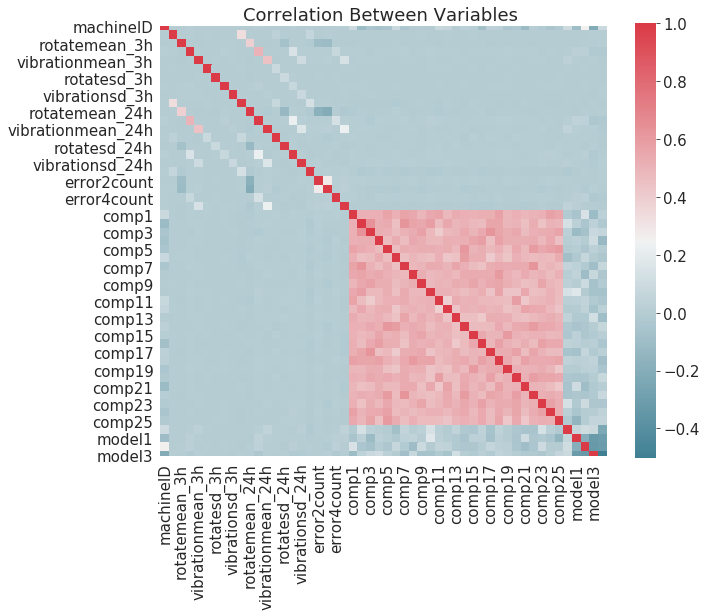

In [107]:
### Correlation Analysis
# It is necessary to eliminate the variables with high correlation (only one), consider> 70%.
f, ax = plt.subplots(figsize=(10, 8))
corr = labeled_features.corr()
sns.heatmap(corr, mask=np.zeros_like(corr, dtype=np.bool), cmap=sns.diverging_palette(220, 10, as_cmap=True),
            square=True, ax=ax)
plt.title("Correlation Between Variables ")
plt.show()

In [108]:
# We save to apply hyper-parameter optimization.
#labeled_features.to_pickle("final_datset.pickle")

In [109]:
# We establish the times corresponding to the records that will be used for training and tests.
import pandas as pd
threshold_dates = [
    pd.to_datetime("2015-09-30 01:00:00"), pd.to_datetime("2015-10-01 01:00:00")
]

In [110]:
test_results = []
models = []
total = len(threshold_dates)

In [111]:
# We make the partition of separate dates.
last_train_date = threshold_dates[0]
first_test_date = threshold_dates[1]

In [112]:
# Typically 20-30% of data is used.
ntraining = labeled_features.loc[labeled_features["datetime"] < last_train_date]
ntesting = labeled_features.loc[labeled_features["datetime"] > first_test_date]
print(f"{ntraining.shape[0]} records for training.")
print(f"{ntesting.shape[0]} records for testing.")
print(f"{ntesting.shape[0] / ntraining.shape[0] * 100:0.1f}% of the data will be used for testing.")

216737 records for training.
73808 records for testing.
34.1% of the data will be used for testing.


In [113]:
fails_train = ntraining[ntraining["failure"] != "none"].shape[0]
no_fails_train = ntraining[ntraining["failure"] == "none"].shape[0]
fails_test = ntesting[ntesting["failure"] != "none"].shape[0]
no_fails_test = ntesting[ntesting["failure"] == "none"].shape[0]

In [114]:
print(f"{fails_train / no_fails_train * 100:0.1f}% of the cases are training set failures.")
print(f"{fails_test / no_fails_test * 100:0.1f}% of the cases are failures in the test set.")

5.0% of the cases are training set failures.
5.2% of the cases are failures in the test set.


In [116]:

# We assign the corresponding values ​​to training and tests.
train_y = labeled_features.loc[labeled_features["datetime"] < last_train_date, "failure"]
train_X = labeled_features.loc[labeled_features["datetime"] < last_train_date].drop(["datetime",
                                                                                    "machineID",
                                                                                    "failure"], axis=1)
test_y = labeled_features.loc[labeled_features["datetime"] > first_test_date, "failure"]
test_X = labeled_features.loc[labeled_features["datetime"] > first_test_date].drop(["datetime",
                                                                                   "machineID",
                                                                                   "failure"], axis=1)

In [117]:
train_y
test_y

2175      none
2176      none
2177      none
2178      none
2179      none
          ... 
291340    none
291341    none
291342    none
291343    none
291344    none
Name: failure, Length: 73808, dtype: category
Categories (26, object): ['comp1', 'comp10', 'comp11', 'comp12', ..., 'comp7', 'comp8', 'comp9', 'none']

In [118]:
train_X

,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,age,model1,model2,model3,model4
0,180.133784,440.608320,94.137969,41.551544,21.322735,48.770512,2.135684,10.037208,169.733809,445.179865,96.797113,40.385160,11.233120,48.717395,10.079880,5.853209,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
1,176.364293,439.349655,101.553209,36.105580,18.952210,51.329636,13.789279,6.737739,170.614862,446.364859,96.849785,39.736826,12.519402,48.385076,10.171540,6.163231,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
2,160.384568,424.385316,99.598722,36.094637,13.047080,13.702496,9.988609,1.639962,169.893965,447.009407,97.715600,39.498374,13.370357,42.432317,9.471669,6.195076,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
3,170.472461,442.933997,102.380586,40.483002,16.642354,56.290447,3.305739,8.854145,171.243444,444.233563,96.666060,40.229370,13.299281,41.346121,8.731229,5.687944,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
4,163.263806,468.937558,102.726648,40.921802,17.424688,38.680380,9.105775,3.060781,170.792486,448.440437,95.766838,40.055214,13.954518,43.490234,8.061653,5.898069,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
290594,155.079380,450.187759,101.838938,44.109299,23.896443,26.392918,10.179211,7.432649,170.528530,444.326173,100.810076,39.376368,14.506501,41.510387,9.177862,5.390787,0.0,0.0,0.0,0.0,0.0,-33.750,109.250,85.250,-20.750,25.250,50.250,171.250,224.250,178.250,9.250,181.250,-42.750,132.250,-59.750,181.250,-5.750,225.250,62.250,240.250,-35.750,-20.750,162.250,-30.750,-84.750,-10.750,5,0,0,0,1
290595,185.390529,435.256907,92.831119,43.530138,18.810846,78.604196,10.683806,0.878059,169.717305,446.631597,99.571418,40.318183,17.743316,41.217863,8.178861,5.776905,0.0,0.0,0.0,0.0,0.0,-33.625,109.375,85.375,-20.625,25.375,50.375,171.375,224.375,178.375,9.375,181.375,-42.625,132.375,-59.625,181.375,-5.625,225.375,62.375,240.375,-35.625,-20.625,162.375,-30.625,-84.625,-10.625,5,0,0,0,1
290596,166.113912,444.157407,103.054512,38.293968,13.242216,34.509446,7.649707,3.353351,171.360297,444.384052,99.005152,40.702089,18.015838,44.986465,8.744985,5.485112,0.0,0.0,0.0,0.0,0.0,-33.500,109.500,85.500,-20.500,25.500,50.500,171.500,224.500,178.500,9.500,181.500,-42.500,132.500,-59.500,181.500,-5.500,225.500,62.500,240.500,-35.500,-20.500,162.500,-30.500,-84.500,-10.500,5,0,0,0,1
290597,157.015479,468.556698,106.294096,42.696208,13.348122,79.293067,7.683379,6.912312,169.644686,443.355974,98.496385,39.750500,18.970203,45.528246,8.341388,5.397306,0.0,0.0,0.0,0.0,0.0,-33.375,109.625,85.625,-20.375,25.625,50.625,171.625,224.625,178.625,9.625,181.625,-42.375,132.625,-59.375,181.625,-5.375,225.625,62.625,240.625,-35.375,-20.375,162.625,-30.375,-84.375,-10.375,5,0,0,0,1


In [119]:
# %%timeit
# Model training.
# model = GradientBoostingClassifier(random_state=42)
model = xgb(n_jobs=-1)
model.fit(train_X, train_y)

[13:43:25] WARNING: ../src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              gamma=0, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=-1,
              num_parallel_tree=1, objective='multi:softprob', predictor='auto',
              random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=None,
              subsample=1, tree_method='exact', validate_parameters=1,
              verbosity=None)

In [120]:
from xgboost import XGBClassifier
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, learning_rate=0.1, max_delta_step=0,
       max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
       n_jobs=-1, nthread=None, objective='multi:softprob', random_state=0,
       reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
       silent=True, subsample=1)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=None, colsample_bytree=1,
              enable_categorical=False, gamma=0, gpu_id=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, monotone_constraints=None,
              n_estimators=100, n_jobs=-1, nthread=None, num_parallel_tree=None,
              objective='multi:softprob', predictor=None, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=True, subsample=1, tree_method=None, ...)

In [121]:
# We obtain results on the test set.
test_result = pd.DataFrame(labeled_features.loc[labeled_features["datetime"] > first_test_date])
test_result["predicted_failure"] = model.predict(test_X)
test_results.append(test_result)
models.append(model)

In [122]:
test_results

[        machineID            datetime  voltmean_3h  rotatemean_3h  \
 2175            1 2015-10-01 03:00:00   170.301017     449.036995   
 2176            1 2015-10-01 06:00:00   165.339972     435.660354   
 2177            1 2015-10-01 09:00:00   183.752875     463.058640   
 2178            1 2015-10-01 12:00:00   177.866822     506.692032   
 2179            1 2015-10-01 15:00:00   167.471524     425.963281   
 ...           ...                 ...          ...            ...   
 291340        100 2015-12-31 18:00:00   177.758754     458.391629   
 291341        100 2015-12-31 21:00:00   166.078945     424.431184   
 291342        100 2016-01-01 00:00:00   158.327984     504.056262   
 291343        100 2016-01-01 03:00:00   170.306956     438.653616   
 291344        100 2016-01-01 06:00:00   182.525427     435.932056   
 
         pressuremean_3h  vibrationmean_3h  voltsd_3h  rotatesd_3h  \
 2175          94.805205         40.816797  11.061667    58.425055   
 2176         103.

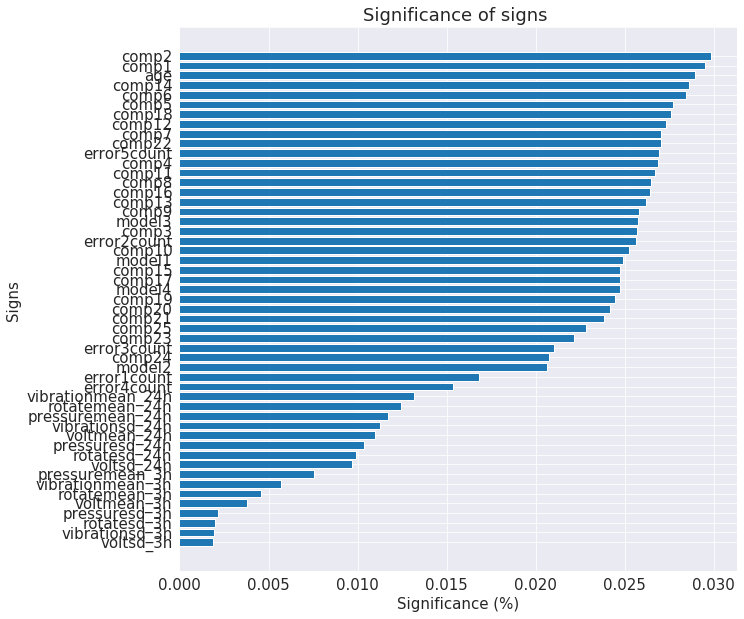

In [123]:
# Below, we plot the feature importances in the (first) trained model
plt.figure(figsize=(10, 10))
labels, importances = zip(*sorted(zip(test_X.columns, models[0].feature_importances_), reverse=False, key=lambda x: x[1]))
plt.yticks(range(len(labels)), labels)
_, labels = plt.xticks()
plt.setp(labels, rotation=0)
plt.barh(range(len(importances)), importances)
plt.ylabel("Signs ")
plt.xlabel("Significance (%)")
plt.title("Significance of signs ")
plt.show()

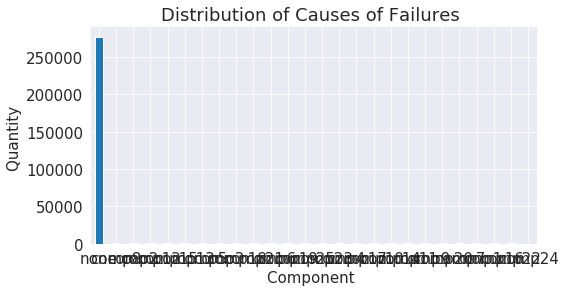

In [124]:
# There is an expected imbalance.
plt.figure(figsize=(8, 4))
labeled_features["failure"].value_counts().plot(kind="bar", rot=0)
plt.title("Distribution of Causes of Failures ")
plt.xlabel("Component ")
plt.ylabel("Quantity ")
plt.show()

In [125]:
def Evaluate(predicted, actual, labels):
    output_labels = []
    output = []
    
    # Calculate and display confusion matrix
    cm = confusion_matrix(actual, predicted, labels=labels)
    #print("Confusion matrix\n- x-axis is true labels (none, comp1, etc.)\n- y-axis is predicted labels")
    #print(cm)
    
    # Calculate precision, recall, and F1 score
    accuracy = np.array([float(np.trace(cm)) / np.sum(cm)] * len(labels))
    precision = precision_score(actual, predicted, average=None, labels=labels)
    recall = recall_score(actual, predicted, average=None, labels=labels)
    f1 = 2 * precision * recall / (precision + recall)
    output.extend([accuracy.tolist(), precision.tolist(), recall.tolist(), f1.tolist()])
    output_labels.extend(["accuracy", "precision", "recall", "F1"])
    
    # Calculate the macro versions of these metrics
    output.extend([[np.mean(precision)] * len(labels),
                   [np.mean(recall)] * len(labels),
                   [np.mean(f1)] * len(labels)])
    output_labels.extend(["macro precision", "macro recall", "macro F1"])
    
    # Find the one-vs.-all confusion matrix
    cm_row_sums = cm.sum(axis = 1)
    cm_col_sums = cm.sum(axis = 0)
    s = np.zeros((2, 2))
    for i in range(len(labels)):
        v = np.array([[cm[i, i],
                       cm_row_sums[i] - cm[i, i]],
                      [cm_col_sums[i] - cm[i, i],
                       np.sum(cm) + cm[i, i] - (cm_row_sums[i] + cm_col_sums[i])]])
        s += v
    s_row_sums = s.sum(axis = 1)
    
    # Add average accuracy and micro-averaged  precision/recall/F1
    avg_accuracy = [np.trace(s) / np.sum(s)] * len(labels)
    micro_prf = [float(s[0,0]) / s_row_sums[0]] * len(labels)
    output.extend([avg_accuracy, micro_prf])
    output_labels.extend(["average accuracy",
                          "micro-averaged precision/recall/F1"])
    
    # Compute metrics for the majority classifier
    mc_index = np.where(cm_row_sums == np.max(cm_row_sums))[0][0]
    cm_row_dist = cm_row_sums / float(np.sum(cm))
    mc_accuracy = 0 * cm_row_dist; mc_accuracy[mc_index] = cm_row_dist[mc_index]
    mc_recall = 0 * cm_row_dist; mc_recall[mc_index] = 1
    mc_precision = 0 * cm_row_dist
    mc_precision[mc_index] = cm_row_dist[mc_index]
    mc_F1 = 0 * cm_row_dist;
    mc_F1[mc_index] = 2 * mc_precision[mc_index] / (mc_precision[mc_index] + 1)
    output.extend([mc_accuracy.tolist(), mc_recall.tolist(),
                   mc_precision.tolist(), mc_F1.tolist()])
    output_labels.extend(["majority class accuracy", "majority class recall",
                          "majority class precision", "majority class F1"])
        
    # Random accuracy and kappa
    cm_col_dist = cm_col_sums / float(np.sum(cm))
    exp_accuracy = np.array([np.sum(cm_row_dist * cm_col_dist)] * len(labels))
    kappa = (accuracy - exp_accuracy) / (1 - exp_accuracy)
    output.extend([exp_accuracy.tolist(), kappa.tolist()])
    output_labels.extend(["expected accuracy", "kappa"])
    

    # Random guess
    rg_accuracy = np.ones(len(labels)) / float(len(labels))
    rg_precision = cm_row_dist
    rg_recall = np.ones(len(labels)) / float(len(labels))
    rg_F1 = 2 * cm_row_dist / (len(labels) * cm_row_dist + 1)
    output.extend([rg_accuracy.tolist(), rg_precision.tolist(),
                   rg_recall.tolist(), rg_F1.tolist()])
    output_labels.extend(["random guess accuracy", "random guess precision",
                          "random guess recall", "random guess F1"])
    
    # Random weighted guess
    rwg_accuracy = np.ones(len(labels)) * sum(cm_row_dist**2)
    rwg_precision = cm_row_dist
    rwg_recall = cm_row_dist
    rwg_F1 = cm_row_dist
    output.extend([rwg_accuracy.tolist(), rwg_precision.tolist(),
                   rwg_recall.tolist(), rwg_F1.tolist()])
    output_labels.extend(["random weighted guess accuracy",
                          "random weighted guess precision",
                          "random weighted guess recall",
                          "random weighted guess F1"])

    output_df = pd.DataFrame(output, columns=labels)
    output_df.index = output_labels
                  
    return output_df



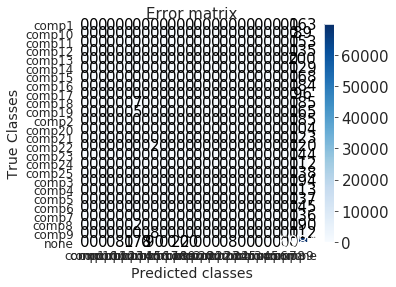

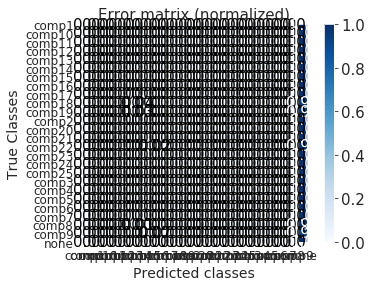

In [126]:
evaluation_results = []
test_result = test_results[0]
evaluation_result = Evaluate(actual = test_result["failure"],
                             predicted = test_result["predicted_failure"],
                             labels = ["none", "comp1",
"comp2",
"comp3",
"comp4",
"comp5",
"comp6",
"comp7",
"comp8",
"comp9",
"comp10",
"comp11",
"comp12",
"comp13",
"comp14",
"comp15",
"comp16",
"comp17",
"comp18",
"comp19",
"comp20",
"comp21",
"comp22",
"comp23",
"comp24",
"comp25"])
skplt.metrics.plot_confusion_matrix(
    test_result["failure"],
    test_result["predicted_failure"],
    normalize=False,
    title=" Error matrix "
)
plt.ylabel(' True Classes ', fontsize=14)
plt.xlabel('Predicted classes ', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.title("Error matrix ", fontsize=15)

skplt.metrics.plot_confusion_matrix(
    test_result["failure"],
    test_result["predicted_failure"],
    normalize=True,
)
plt.ylabel('True Classes', fontsize=14)
plt.xlabel('Predicted classes', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.title("Error matrix (normalized)", fontsize=15)

plt.show()



In [127]:
evaluation_results.append(evaluation_result)
evaluation_results[0]  # show full results for first split only

,none,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25
accuracy,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239
precision,0.950721,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
recall,0.995382,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
F1,0.972539,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
macro precision,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566,0.036566
macro recall,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284,0.038284
macro F1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
average accuracy,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865,0.995865
micro-averaged precision/recall/F1,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239,0.946239
majority class accuracy,0.950629,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [128]:
evaluation_results[0].mean(axis=1)[0:4]

accuracy     0.946239
precision    0.036566
recall       0.038284
F1           0.972539
dtype: float64

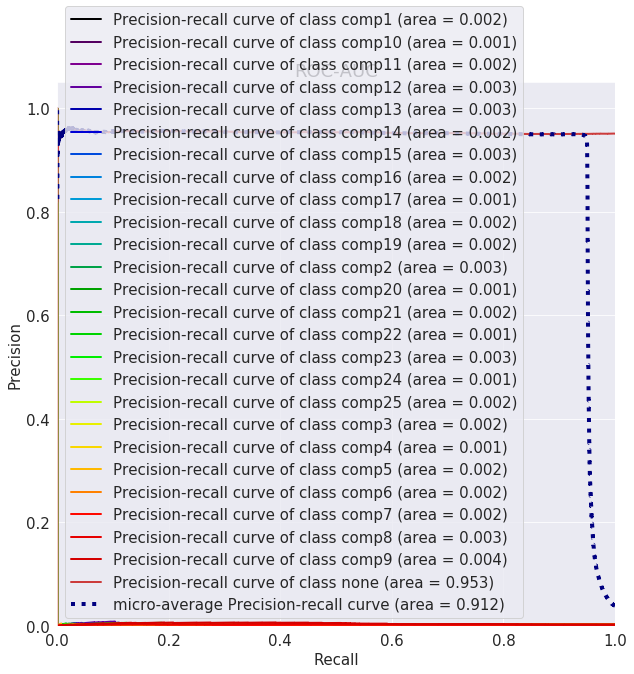

In [129]:
# For a binary classification problem, the ROC-AUC curve is generally used..
# For this multi-class case we will use precision vs sensitivity.
skplt.metrics.plot_precision_recall_curve(
    test_y,
    model.predict_proba(test_X),
    title="ROC-AUC",
    figsize=(10,10)
)
plt.show()

In [130]:
evaluation_results[0].loc["recall"].values

array([0.99538225, 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        ])

In [132]:
recall_df = pd.DataFrame([evaluation_results[0].loc["recall"].values],
                         columns=["none", "comp1",
"comp2",
"comp3",
"comp4",
"comp5",
"comp6",
"comp7",
"comp8",
"comp9",
"comp10",
"comp11",
"comp12",
"comp13",
"comp14",
"comp15",
"comp16",
"comp17",
"comp18",
"comp19",
"comp20",
"comp21",
"comp22",
"comp23",
"comp24",
"comp25"],index=[" Component Sensitivity "])
recall_df.T

,Component Sensitivity
none,0.995382
comp1,0.000000
comp2,0.000000
comp3,0.000000
comp4,0.000000
comp5,0.000000
comp6,0.000000
comp7,0.000000
comp8,0.000000
comp9,0.000000


In [99]:
###Individual Test Case

In [156]:
test_values = train_X.iloc[0].values
test_values

array([180.13378397, 440.60832011,  94.1379695 ,  41.55154363,
        21.32273479,  48.77051197,   2.13568373,  10.03720806,
       169.7338089 , 445.1798646 ,  96.79711296,  40.38515999,
        11.23312028,  48.71739478,  10.07988023,   5.85320856,
         0.        ,   0.        ,   0.        ,   0.        ,
         0.        ,          nan,          nan,          nan,
                nan,          nan,          nan,          nan,
                nan,          nan,          nan,          nan,
                nan,          nan,          nan,          nan,
                nan,          nan,          nan,          nan,
                nan,          nan,          nan,          nan,
                nan,          nan,  18.        ,   0.        ,
         0.        ,   1.        ,   0.        ])

In [157]:
train_X

,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,age,model1,model2,model3,model4
0,180.133784,440.608320,94.137969,41.551544,21.322735,48.770512,2.135684,10.037208,169.733809,445.179865,96.797113,40.385160,11.233120,48.717395,10.079880,5.853209,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
1,176.364293,439.349655,101.553209,36.105580,18.952210,51.329636,13.789279,6.737739,170.614862,446.364859,96.849785,39.736826,12.519402,48.385076,10.171540,6.163231,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
2,160.384568,424.385316,99.598722,36.094637,13.047080,13.702496,9.988609,1.639962,169.893965,447.009407,97.715600,39.498374,13.370357,42.432317,9.471669,6.195076,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
3,170.472461,442.933997,102.380586,40.483002,16.642354,56.290447,3.305739,8.854145,171.243444,444.233563,96.666060,40.229370,13.299281,41.346121,8.731229,5.687944,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
4,163.263806,468.937558,102.726648,40.921802,17.424688,38.680380,9.105775,3.060781,170.792486,448.440437,95.766838,40.055214,13.954518,43.490234,8.061653,5.898069,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
290713,155.079380,450.187759,101.838938,44.109299,23.896443,26.392918,10.179211,7.432649,170.528530,444.326173,100.810076,39.376368,14.506501,41.510387,9.177862,5.390787,0.0,0.0,0.0,0.0,0.0,-33.750,109.250,-8.750,-2.750,25.250,9.250,171.250,172.250,-29.750,9.250,86.250,-42.750,132.250,-59.750,66.250,-5.750,-8.750,62.250,26.250,-35.750,-89.750,162.250,23.250,-84.750,168.250,5,0,0,0,1
290714,185.390529,435.256907,92.831119,43.530138,18.810846,78.604196,10.683806,0.878059,169.717305,446.631597,99.571418,40.318183,17.743316,41.217863,8.178861,5.776905,0.0,0.0,0.0,0.0,0.0,-33.625,109.375,-8.625,-2.625,25.375,9.375,171.375,172.375,-29.625,9.375,86.375,-42.625,132.375,-59.625,66.375,-5.625,-8.625,62.375,26.375,-35.625,-89.625,162.375,23.375,-84.625,168.375,5,0,0,0,1
290715,166.113912,444.157407,103.054512,38.293968,13.242216,34.509446,7.649707,3.353351,171.360297,444.384052,99.005152,40.702089,18.015838,44.986465,8.744985,5.485112,0.0,0.0,0.0,0.0,0.0,-33.500,109.500,-8.500,-2.500,25.500,9.500,171.500,172.500,-29.500,9.500,86.500,-42.500,132.500,-59.500,66.500,-5.500,-8.500,62.500,26.500,-35.500,-89.500,162.500,23.500,-84.500,168.500,5,0,0,0,1
290716,157.015479,468.556698,106.294096,42.696208,13.348122,79.293067,7.683379,6.912312,169.644686,443.355974,98.496385,39.750500,18.970203,45.528246,8.341388,5.397306,0.0,0.0,0.0,0.0,0.0,-33.375,109.625,-8.375,-2.375,25.625,9.625,171.625,172.625,-29.375,9.625,86.625,-42.375,132.625,-59.375,66.625,-5.375,-8.375,62.625,26.625,-35.375,-89.375,162.625,23.625,-84.375,168.625,5,0,0,0,1


In [158]:
# XGBoost accepts only 2-dimensional arrays.
single_test = pd.DataFrame([test_values], columns=test_X.columns, index=[0])
single_test

,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,age,model1,model2,model3,model4
0,180.133784,440.60832,94.137969,41.551544,21.322735,48.770512,2.135684,10.037208,169.733809,445.179865,96.797113,40.38516,11.23312,48.717395,10.07988,5.853209,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18.0,0.0,0.0,1.0,0.0


In [159]:
probas = model.predict_proba(single_test)
probas

array([[1.0500560e-09, 9.2104291e-10, 4.4156484e-10, 1.8663193e-09,
        4.6684310e-09, 1.3833610e-06, 4.9752380e-09, 1.2524624e-08,
        3.6797159e-09, 9.5691057e-08, 1.9582376e-09, 7.2734906e-08,
        1.5823424e-09, 1.3766706e-09, 1.2741820e-08, 3.0565090e-09,
        1.8330252e-07, 4.4174615e-09, 8.4236972e-06, 2.0406785e-06,
        2.5591629e-09, 2.4231954e-07, 9.6290753e-10, 4.1406240e-10,
        1.1129263e-09, 9.9998748e-01]], dtype=float32)

In [160]:
prediction = model.predict(single_test)
prediction

array(['none'], dtype=object)

In [161]:
ordered_classes = np.unique(np.array(test_y))
ordered_classes

array(['comp1', 'comp10', 'comp11', 'comp12', 'comp13', 'comp14',
       'comp15', 'comp16', 'comp17', 'comp18', 'comp19', 'comp2',
       'comp20', 'comp21', 'comp22', 'comp23', 'comp24', 'comp25',
       'comp3', 'comp4', 'comp5', 'comp6', 'comp7', 'comp8', 'comp9',
       'none'], dtype=object)

In [162]:
gr_test = pd.DataFrame(test_X.values, columns=test_X.columns)
gr_test

,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,age,model1,model2,model3,model4
0,170.301017,449.036995,94.805205,40.816797,11.061667,58.425055,4.931305,2.428740,178.008406,453.336357,102.683692,40.038613,15.281376,51.271446,7.982720,5.003900,0.0,0.0,0.0,0.0,0.0,NaN,70.875,153.875,157.875,143.875,88.875,NaN,72.875,NaN,20.875,183.875,NaN,26.875,237.875,90.875,NaN,NaN,18.875,138.875,14.875,69.875,247.875,NaN,70.875,185.875,18.0,0.0,0.0,1.0,0.0
1,165.339972,435.660354,103.351320,31.892462,10.717864,26.009485,22.071933,6.020669,178.277009,452.064940,103.387953,40.382551,14.604326,54.077142,9.479323,4.621571,0.0,0.0,0.0,0.0,0.0,NaN,71.000,154.000,158.000,144.000,89.000,NaN,73.000,NaN,21.000,184.000,NaN,27.000,238.000,91.000,NaN,NaN,19.000,139.000,15.000,70.000,248.000,NaN,71.000,186.000,18.0,0.0,0.0,1.0,0.0
2,183.752875,463.058640,109.525083,41.945037,9.369264,43.646584,10.859804,9.395067,176.380067,444.022795,103.622701,38.885907,15.021543,50.702138,10.559279,5.258601,0.0,0.0,0.0,0.0,0.0,NaN,71.125,154.125,158.125,144.125,89.125,NaN,73.125,NaN,21.125,184.125,NaN,27.125,238.125,91.125,NaN,NaN,19.125,139.125,15.125,70.125,248.125,NaN,71.125,186.125,18.0,0.0,0.0,1.0,0.0
3,177.866822,506.692032,98.745260,39.861149,16.596090,38.086352,10.410456,5.418325,176.356632,457.097293,102.904755,38.625804,14.562010,50.034820,10.837744,5.589588,0.0,0.0,0.0,0.0,0.0,NaN,71.250,154.250,158.250,144.250,89.250,NaN,73.250,NaN,21.250,184.250,NaN,27.250,238.250,91.250,NaN,NaN,19.250,139.250,15.250,70.250,248.250,NaN,71.250,186.250,18.0,0.0,0.0,1.0,0.0
4,167.471524,425.963281,111.996389,39.396999,9.015089,63.342755,4.648154,6.365146,177.911567,453.677320,103.111088,39.028015,14.642907,45.384165,10.816778,5.485460,0.0,0.0,0.0,0.0,0.0,NaN,71.375,154.375,158.375,144.375,89.375,NaN,73.375,NaN,21.375,184.375,NaN,27.375,238.375,91.375,NaN,NaN,19.375,139.375,15.375,70.375,248.375,NaN,71.375,186.375,18.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73836,177.758754,458.391629,103.183160,46.846592,13.147011,75.100940,3.111700,3.576693,169.764418,454.478787,100.873360,39.094339,15.331755,60.839923,7.891711,5.269038,0.0,0.0,0.0,0.0,0.0,59.500,202.500,84.500,90.500,118.500,102.500,264.500,265.500,63.500,102.500,179.500,50.500,225.500,33.500,159.500,87.500,84.500,155.500,119.500,57.500,3.500,255.500,116.500,8.500,261.500,5.0,0.0,0.0,0.0,1.0
73837,166.078945,424.431184,98.344409,30.907459,29.351231,69.348245,16.940674,3.731256,171.547643,452.351565,101.789714,39.184285,16.429023,62.147934,7.475540,5.448962,0.0,0.0,0.0,0.0,0.0,59.625,202.625,84.625,90.625,118.625,102.625,264.625,265.625,63.625,102.625,179.625,50.625,225.625,33.625,159.625,87.625,84.625,155.625,119.625,57.625,3.625,255.625,116.625,8.625,261.625,5.0,0.0,0.0,0.0,1.0
73838,158.327984,504.056262,108.055441,40.109705,9.605817,78.036116,9.154932,3.379639,168.806645,459.502212,100.919285,38.150193,17.019808,64.730136,8.961444,5.833191,0.0,0.0,0.0,0.0,0.0,59.750,202.750,84.750,90.750,118.750,102.750,264.750,265.750,63.750,102.750,179.750,50.750,225.750,33.750,159.750,87.750,84.750,155.750,119.750,57.750,3.750,255.750,116.750,8.750,261.750,5.0,0.0,0.0,0.0,1.0
73839,170.306956,438.653616,102.346227,47.481232,8.457322,43.021553,0.785721,3.198928,169.011763,465.923073,101.568092,39.456302,17.096392,64.718132,9.420879,5.738756,0.0,0.0,0.0,0.0,0.0,59.875,202.875,84.875,90.875,118.875,102.875,264.875,265.875,63.875,102.875,179.875,50.875,225.87

In [163]:
probas = model.predict_proba(gr_test)
prediction = model.predict(gr_test)
prediction

array(['none', 'none', 'none', ..., 'none', 'none', 'none'], dtype=object)

In [164]:
ordered_classes = np.unique(np.array(test_y))
ordered_classes

array(['comp1', 'comp10', 'comp11', 'comp12', 'comp13', 'comp14',
       'comp15', 'comp16', 'comp17', 'comp18', 'comp19', 'comp2',
       'comp20', 'comp21', 'comp22', 'comp23', 'comp24', 'comp25',
       'comp3', 'comp4', 'comp5', 'comp6', 'comp7', 'comp8', 'comp9',
       'none'], dtype=object)

In [165]:
results = pd.DataFrame(probas,
                       columns=ordered_classes)
results

,comp1,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp2,comp20,comp21,comp22,comp23,comp24,comp25,comp3,comp4,comp5,comp6,comp7,comp8,comp9,none
0,3.139430e-07,1.550480e-07,1.203111e-07,0.000054,0.000033,0.000051,0.000164,0.000011,0.000108,0.000058,0.000032,0.000008,8.176476e-07,6.221441e-08,0.000013,0.000002,0.000008,0.000002,0.000115,0.000002,0.000003,0.000048,1.424330e-07,2.058513e-07,6.596075e-07,0.999284
1,2.248890e-07,3.330079e-07,1.081704e-07,0.000049,0.000029,0.000042,0.000163,0.000008,0.000065,0.000047,0.000013,0.000046,9.628003e-07,7.624353e-08,0.000008,0.000002,0.000008,0.000002,0.000106,0.000002,0.000004,0.000050,1.219131e-07,1.605241e-07,5.202504e-07,0.999352
2,2.562215e-07,4.237717e-07,9.324890e-08,0.000103,0.000038,0.000014,0.000175,0.000012,0.000233,0.000068,0.000021,0.000011,1.004574e-06,6.342270e-08,0.000016,0.000003,0.000013,0.000003,0.000267,0.000004,0.000003,0.000082,2.452488e-07,2.751968e-07,8.942862e-07,0.998933
3,3.434616e-07,3.050249e-07,1.208869e-07,0.000102,0.000035,0.000018,0.000201,0.000014,0.000228,0.000069,0.000022,0.000010,9.386187e-07,6.526747e-08,0.000017,0.000003,0.000013,0.000003,0.000234,0.000006,0.000003,0.000175,2.503301e-07,2.446491e-07,1.087034e-06,0.998842
4,3.407660e-07,5.008482e-07,1.001484e-07,0.000057,0.000021,0.000013,0.000169,0.000008,0.000168,0.000039,0.000021,0.000011,7.649939e-07,4.876359e-08,0.000013,0.000003,0.000009,0.000002,0.000074,0.000002,0.000003,0.000065,2.119542e-07,1.973922e-07,6.858290e-07,0.999320
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73836,9.452407e-04,3.189192e-02,2.251077e-03,0.000679,0.007100,0.000499,0.134438,0.001107,0.003330,0.000765,0.002097,0.014271,1.043897e-02,1.707979e-04,0.000453,0.006136,0.101857,0.000725,0.002924,0.004502,0.002899,0.004782,1.000275e-03,5.464627e-03,2.084162e-04,0.659065
73837,1.823492e-03,1.267129e-02,1.925207e-03,0.000600,0.028805,0.000383,0.112156,0.000745,0.002103,0.000898,0.002004,0.018318,8.732503e-03,1.664253e-04,0.000331,0.005691,0.121275,0.000564,0.001674,0.005396,0.001027,0.001700,9.793828e-04,7.443266e-03,1.926422e-04,0.662396
73838,1.078220e-03,4.567489e-02,1.805639e-03,0.001110,0.004991,0.000573,0.086526,0.001020,0.002221,0.000739,0.002842,0.011448,8.657653e-03,1.442386e-04,0.000452,0.006393,0.136156,0.000564,0.001126,0.004673,0.001957,0.006946,1.151984e-03,5.414189e-03,1.611068e-04,0.666175
73839,1.267843e-03,3.263024e-02,2.234678e-03,0.000714,0.004299,0.000773,0.136290,0.000739,0.002586,0.000947,0.003078,0.019662,9.139330e-03,1.701144e-04,0.000431,0.008910,0.085993,0.000599,0.001007,0.004970,0.001648,0.006153,1.350208e-03,5.572234e-03,1.831990e-04,0.668653


In [166]:
print(f" Prediction: {prediction}")
results

 Prediction: ['none' 'none' 'none' ... 'none' 'none' 'none']


,comp1,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp2,comp20,comp21,comp22,comp23,comp24,comp25,comp3,comp4,comp5,comp6,comp7,comp8,comp9,none
0,3.139430e-07,1.550480e-07,1.203111e-07,0.000054,0.000033,0.000051,0.000164,0.000011,0.000108,0.000058,0.000032,0.000008,8.176476e-07,6.221441e-08,0.000013,0.000002,0.000008,0.000002,0.000115,0.000002,0.000003,0.000048,1.424330e-07,2.058513e-07,6.596075e-07,0.999284
1,2.248890e-07,3.330079e-07,1.081704e-07,0.000049,0.000029,0.000042,0.000163,0.000008,0.000065,0.000047,0.000013,0.000046,9.628003e-07,7.624353e-08,0.000008,0.000002,0.000008,0.000002,0.000106,0.000002,0.000004,0.000050,1.219131e-07,1.605241e-07,5.202504e-07,0.999352
2,2.562215e-07,4.237717e-07,9.324890e-08,0.000103,0.000038,0.000014,0.000175,0.000012,0.000233,0.000068,0.000021,0.000011,1.004574e-06,6.342270e-08,0.000016,0.000003,0.000013,0.000003,0.000267,0.000004,0.000003,0.000082,2.452488e-07,2.751968e-07,8.942862e-07,0.998933
3,3.434616e-07,3.050249e-07,1.208869e-07,0.000102,0.000035,0.000018,0.000201,0.000014,0.000228,0.000069,0.000022,0.000010,9.386187e-07,6.526747e-08,0.000017,0.000003,0.000013,0.000003,0.000234,0.000006,0.000003,0.000175,2.503301e-07,2.446491e-07,1.087034e-06,0.998842
4,3.407660e-07,5.008482e-07,1.001484e-07,0.000057,0.000021,0.000013,0.000169,0.000008,0.000168,0.000039,0.000021,0.000011,7.649939e-07,4.876359e-08,0.000013,0.000003,0.000009,0.000002,0.000074,0.000002,0.000003,0.000065,2.119542e-07,1.973922e-07,6.858290e-07,0.999320
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73836,9.452407e-04,3.189192e-02,2.251077e-03,0.000679,0.007100,0.000499,0.134438,0.001107,0.003330,0.000765,0.002097,0.014271,1.043897e-02,1.707979e-04,0.000453,0.006136,0.101857,0.000725,0.002924,0.004502,0.002899,0.004782,1.000275e-03,5.464627e-03,2.084162e-04,0.659065
73837,1.823492e-03,1.267129e-02,1.925207e-03,0.000600,0.028805,0.000383,0.112156,0.000745,0.002103,0.000898,0.002004,0.018318,8.732503e-03,1.664253e-04,0.000331,0.005691,0.121275,0.000564,0.001674,0.005396,0.001027,0.001700,9.793828e-04,7.443266e-03,1.926422e-04,0.662396
73838,1.078220e-03,4.567489e-02,1.805639e-03,0.001110,0.004991,0.000573,0.086526,0.001020,0.002221,0.000739,0.002842,0.011448,8.657653e-03,1.442386e-04,0.000452,0.006393,0.136156,0.000564,0.001126,0.004673,0.001957,0.006946,1.151984e-03,5.414189e-03,1.611068e-04,0.666175
73839,1.267843e-03,3.263024e-02,2.234678e-03,0.000714,0.004299,0.000773,0.136290,0.000739,0.002586,0.000947,0.003078,0.019662,9.139330e-03,1.701144e-04,0.000431,0.008910,0.085993,0.000599,0.001007,0.004970,0.001648,0.006153,1.350208e-03,5.572234e-03,1.831990e-04,0.668653


In [167]:
np.unique(prediction, return_counts = True)

(array(['comp1', 'comp10', 'comp12', 'comp13', 'comp18', 'comp2', 'comp20',
        'comp21', 'comp23', 'comp24', 'comp25', 'comp3', 'comp4', 'comp6',
        'comp7', 'comp8', 'comp9', 'none'], dtype=object),
 array([    4,    76,   160,    14,   438,   300,   194,   261,     6,
           99,    41,    12,    59,    37,   227,     4,     7, 71902]))

In [168]:
for i, j in zip(prediction, range(len(prediction))):
    if i != 'none':
        print(prediction[j], 1-results.none[j])

comp24 0.597192257642746
comp12 0.6634327173233032
comp12 0.7184173166751862
comp12 0.7662117034196854
comp12 0.7728351801633835
comp12 0.7619614154100418
comp12 0.7934688776731491
comp12 0.8080411404371262
comp12 0.7650930136442184
comp12 0.7411258518695831
comp12 0.708881288766861
comp12 0.6924349963665009
comp12 0.6708457171916962
comp12 0.7433375418186188
comp12 0.7950621694326401
comp12 0.8634168356657028
comp12 0.78855861723423
comp12 0.8022360503673553
comp12 0.7923257797956467
comp12 0.7987852245569229
comp12 0.7370138168334961
comp12 0.8432679623365402
comp12 0.8219446986913681
comp12 0.8028743714094162
comp12 0.8936030864715576
comp12 0.8154954761266708
comp12 0.8381655663251877
comp12 0.6905852556228638
comp12 0.8303273320198059
comp12 0.7372340261936188
comp12 0.8287982046604156
comp12 0.8548544943332672
comp12 0.8557535856962204
comp12 0.8450039923191071
comp12 0.8518113791942596
comp12 0.8300192058086395
comp12 0.7645429223775864
comp12 0.7536199986934662
comp12 0.7012366

comp21 0.6551865041255951
comp21 0.8994457647204399
comp21 0.908974789083004
comp21 0.8819702044129372
comp12 0.7749124318361282
comp12 0.7724248468875885
comp21 0.8878050222992897
comp12 0.8451065421104431
comp21 0.9298286959528923
comp20 0.896760456264019
comp25 0.8269623816013336
comp20 0.8852707073092461
comp12 0.8734297603368759
comp12 0.9162202626466751
comp12 0.889888308942318
comp25 0.9106568917632103
comp12 0.9218100383877754
comp12 0.8875316977500916
comp20 0.8940610066056252
comp20 0.8308229297399521
comp20 0.8322055786848068
comp21 0.8517863154411316
comp20 0.8859146311879158
comp20 0.8959370777010918
comp20 0.9115569517016411
comp20 0.869834303855896
comp20 0.8859478607773781
comp20 0.8512080162763596
comp21 0.8364774733781815
comp21 0.7922504246234894
comp21 0.8198092728853226
comp21 0.8741952776908875
comp21 0.8673878014087677
comp20 0.776143878698349
comp20 0.860898032784462
comp21 0.821042463183403
comp21 0.8590001165866852
comp21 0.7859741151332855
comp21 0.8196162730

In [169]:
test_X.head()

,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,age,model1,model2,model3,model4
2175,170.301017,449.036995,94.805205,40.816797,11.061667,58.425055,4.931305,2.428740,178.008406,453.336357,102.683692,40.038613,15.281376,51.271446,7.982720,5.003900,0.0,0.0,0.0,0.0,0.0,NaN,70.875,153.875,157.875,143.875,88.875,NaN,72.875,NaN,20.875,183.875,NaN,26.875,237.875,90.875,NaN,NaN,18.875,138.875,14.875,69.875,247.875,NaN,70.875,185.875,18,0,0,1,0
2176,165.339972,435.660354,103.351320,31.892462,10.717864,26.009485,22.071933,6.020669,178.277009,452.064940,103.387953,40.382551,14.604326,54.077142,9.479323,4.621571,0.0,0.0,0.0,0.0,0.0,NaN,71.000,154.000,158.000,144.000,89.000,NaN,73.000,NaN,21.000,184.000,NaN,27.000,238.000,91.000,NaN,NaN,19.000,139.000,15.000,70.000,248.000,NaN,71.000,186.000,18,0,0,1,0
2177,183.752875,463.058640,109.525083,41.945037,9.369264,43.646584,10.859804,9.395067,176.380067,444.022795,103.622701,38.885907,15.021543,50.702138,10.559279,5.258601,0.0,0.0,0.0,0.0,0.0,NaN,71.125,154.125,158.125,144.125,89.125,NaN,73.125,NaN,21.125,184.125,NaN,27.125,238.125,91.125,NaN,NaN,19.125,139.125,15.125,70.125,248.125,NaN,71.125,186.125,18,0,0,1,0
2178,177.866822,506.692032,98.745260,39.861149,16.596090,38.086352,10.410456,5.418325,176.356632,457.097293,102.904755,38.625804,14.562010,50.034820,10.837744,5.589588,0.0,0.0,0.0,0.0,0.0,NaN,71.250,154.250,158.250,144.250,89.250,NaN,73.250,NaN,21.250,184.250,NaN,27.250,238.250,91.250,NaN,NaN,19.250,139.250,15.250,70.250,248.250,NaN,71.250,186.250,18,0,0,1,0
2179,167.471524,425.963281,111.996389,39.396999,9.015089,63.342755,4.648154,6.365146,177.911567,453.677320,103.111088,39.028015,14.642907,45.384165,10.816778,5.485460,0.0,0.0,0.0,0.0,0.0,NaN,71.375,154.375,158.375,144.375,89.375,NaN,73.375,NaN,21.375,184.375,NaN,27.375,238.375,91.375,NaN,NaN,19.375,139.375,15.375,70.375,248.375,NaN,71.375,186.375,18,0,0,1,0


In [170]:
train_X.head(20)

,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,age,model1,model2,model3,model4
0,180.133784,440.608320,94.137969,41.551544,21.322735,48.770512,2.135684,10.037208,169.733809,445.179865,96.797113,40.385160,11.233120,48.717395,10.079880,5.853209,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
1,176.364293,439.349655,101.553209,36.105580,18.952210,51.329636,13.789279,6.737739,170.614862,446.364859,96.849785,39.736826,12.519402,48.385076,10.171540,6.163231,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
2,160.384568,424.385316,99.598722,36.094637,13.047080,13.702496,9.988609,1.639962,169.893965,447.009407,97.715600,39.498374,13.370357,42.432317,9.471669,6.195076,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
3,170.472461,442.933997,102.380586,40.483002,16.642354,56.290447,3.305739,8.854145,171.243444,444.233563,96.666060,40.229370,13.299281,41.346121,8.731229,5.687944,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
4,163.263806,468.937558,102.726648,40.921802,17.424688,38.680380,9.105775,3.060781,170.792486,448.440437,95.766838,40.055214,13.954518,43.490234,8.061653,5.898069,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
5,163.278466,446.493166,104.387585,38.068116,21.580492,41.380958,20.725597,6.932127,170.556674,452.267095,98.065860,40.033247,14.402740,42.626186,10.408012,5.941890,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
6,172.191198,434.214692,93.747282,39.716482,16.369836,14.636041,18.817326,3.426997,168.460525,451.031783,99.273286,38.903462,15.513819,40.395881,10.833294,5.737671,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
7,175.210027,504.845430,108.512153,37.763933,5.991921,16.062702,6.382608,3.449468,169.772951,447.502464,99.005946,39.389725,15.726970,39.648116,11.904700,5.601191,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
8,181.690108,472.783187,93.395164,38.621099,11.514450,47.880443,2.177029,7.670520,170.900562,453.864597,100.877342,38.696225,15.635083,41.828592,11.326412,5.583521,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0
9,172.382935,505.141261,98.524373,49.965572,7.065150,56.849540,5.230039,2.687565,169.533156,454.785072,100.050567,39.449734,13.995465,40.843882,11.036546,5.561553,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,0,0,1,0


In [171]:
train_y.head(100)

0     none
1     none
2     none
3     none
4     none
5     none
6     none
7     none
8     none
9     none
10    none
11    none
12    none
13    none
14    none
15    none
16    none
17    none
18    none
19    none
20    none
21    none
22    none
23    none
24    none
25    none
26    none
27    none
28    none
29    none
30    none
31    none
32    none
33    none
34    none
35    none
36    none
37    none
38    none
39    none
40    none
41    none
42    none
43    none
44    none
45    none
46    none
47    none
48    none
49    none
50    none
51    none
52    none
53    none
54    none
55    none
56    none
57    none
58    none
59    none
60    none
61    none
62    none
63    none
64    none
65    none
66    none
67    none
68    none
69    none
70    none
71    none
72    none
73    none
74    none
75    none
76    none
77    none
78    none
79    none
80    none
81    none
82    none
83    none
84    none
85    none
86    none
87    none
88    none
89    none
90    none

In [172]:
labeled_features.loc[labeled_features['failure'] != 'none'].sample(5)

,machineID,datetime,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,age,failure,model1,model2,model3,model4
118911,41,2015-10-21 06:00:00,178.597661,434.611594,91.626541,34.143848,14.052780,7.268827,14.294854,9.086383,170.208530,462.786719,97.365278,40.776230,17.358955,49.045048,8.535949,4.953647,0.0,0.0,0.0,0.0,0.0,72.000,175.000,125.000,80.000,58.000,173.000,168.000,61.000,125.000,137.000,-62.000,195.000,98.000,45.000,36.000,-47.000,287.000,57.000,82.000,52.000,123.000,159.000,46.000,4.000,112.000,9,comp5,0,0,0,1
197319,68,2015-09-13 21:00:00,183.483895,419.003001,107.177207,37.735783,19.457087,67.834965,7.822597,4.320959,171.377039,436.470393,100.728666,40.207573,18.080872,49.151252,10.142300,5.712553,0.0,0.0,0.0,0.0,0.0,173.625,120.625,136.625,204.625,37.625,7.625,148.625,78.625,152.625,181.625,215.625,-2.375,45.625,20.625,39.625,93.625,166.625,11.625,-6.375,80.625,12.625,79.625,-20.375,-2.375,103.625,10,comp24,0,0,1,0
161159,56,2015-04-19 18:00:00,173.932629,444.206081,90.668434,39.065173,7.369740,46.302180,9.689655,10.354166,170.844985,427.479098,96.409994,39.485064,18.476933,42.591935,9.798940,5.151280,0.0,0.0,0.0,0.0,0.0,21.500,-180.500,78.500,73.500,-200.500,-191.500,14.500,-21.500,53.500,30.500,-255.500,-244.500,-227.500,58.500,39.500,-32.500,-208.500,21.500,13.500,45.500,91.500,-190.500,25.500,-34.500,58.500,10,comp1,1,0,0,0
137145,48,2015-01-22 21:00:00,170.289883,447.674620,109.806738,37.715294,12.895890,53.323787,1.538816,7.677639,166.933649,446.936050,100.044956,40.192014,12.657895,54.923878,8.164073,3.613872,0.0,0.0,0.0,0.0,0.0,16.625,-264.375,-183.375,0.625,-249.375,8.625,3.625,-284.375,-180.375,-297.375,-85.375,18.625,-342.375,18.625,-337.375,-58.375,-179.375,-138.375,-240.375,16.625,6.625,-305.375,-194.375,-233.375,-249.375,10,comp21,0,0,0,1
221687,77,2015-01-24 00:00:00,172.850230,457.765193,101.236782,40.585532,23.679132,57.152671,8.540362,0.868975,173.928744,459.746260,100.197819,39.186355,13.657068,43.272436,6.913677,5.678696,0.0,0.0,0.0,0.0,0.0,-341.250,-292.250,-339.250,-297.250,-152.250,-234.250,-218.250,-321.250,-297.250,-182.250,-330.250,-304.250,-67.250,-263.250,-114.250,6.750,-217.250,-310.250,18.750,-207.250,-328.250,7.750,-209.250,16.750,-236.250,12,comp16,0,0,0,1


In [173]:
test_value_2 = train_X.iloc[41].values
test_value_2


array([181.63907118, 436.47529141,  96.87547103,  38.71848351,
         8.32522606,  15.81616351,  11.54092924,   9.24042479,
       171.62519627, 441.77489331, 101.00085373,  41.91757646,
        17.77700454,  44.16107652,  10.08854208,   3.98590447,
         0.        ,   0.        ,   0.        ,   0.        ,
         0.        ,          nan,          nan,          nan,
                nan,          nan,          nan,          nan,
                nan,          nan,          nan,   3.125     ,
                nan,          nan,          nan,          nan,
                nan,          nan,          nan,          nan,
                nan,          nan,          nan,          nan,
                nan,          nan,  18.        ,   0.        ,
         0.        ,   1.        ,   0.        ])

In [174]:
single_test_2 = pd.DataFrame([test_value_2], columns=test_X.columns, index=[0])
single_test_2


,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,age,model1,model2,model3,model4
0,181.639071,436.475291,96.875471,38.718484,8.325226,15.816164,11.540929,9.240425,171.625196,441.774893,101.000854,41.917576,17.777005,44.161077,10.088542,3.985904,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.125,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18.0,0.0,0.0,1.0,0.0


In [175]:
prediction = model.predict(single_test_2)
prediction

array(['none'], dtype=object)

In [176]:
test_value_3 = train_X.iloc[44].values
test_value_3

array([165.78163772, 469.22605798, 101.85098974,  43.17389047,
        13.54652233,  33.02911546,   8.85356156,   5.15477144,
       170.57793684, 448.12292961,  99.72127252,  41.37960303,
        13.89543209,  39.79592558,  11.46734835,   5.38867778,
         0.        ,   0.        ,   0.        ,   0.        ,
         0.        ,          nan,          nan,          nan,
                nan,          nan,          nan,          nan,
                nan,          nan,          nan,   3.5       ,
                nan,          nan,          nan,          nan,
                nan,          nan,          nan,          nan,
                nan,          nan,          nan,          nan,
                nan,          nan,  18.        ,   0.        ,
         0.        ,   1.        ,   0.        ])

In [177]:
single_test_3 = pd.DataFrame([test_value_3], columns=test_X.columns, index=[0])
single_test_3

,voltmean_3h,rotatemean_3h,pressuremean_3h,vibrationmean_3h,voltsd_3h,rotatesd_3h,pressuresd_3h,vibrationsd_3h,voltmean_24h,rotatemean_24h,pressuremean_24h,vibrationmean_24h,voltsd_24h,rotatesd_24h,pressuresd_24h,vibrationsd_24h,error1count,error2count,error3count,error4count,error5count,comp1,comp2,comp3,comp4,comp5,comp6,comp7,comp8,comp9,comp10,comp11,comp12,comp13,comp14,comp15,comp16,comp17,comp18,comp19,comp20,comp21,comp22,comp23,comp24,comp25,age,model1,model2,model3,model4
0,165.781638,469.226058,101.85099,43.17389,13.546522,33.029115,8.853562,5.154771,170.577937,448.12293,99.721273,41.379603,13.895432,39.795926,11.467348,5.388678,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18.0,0.0,0.0,1.0,0.0


In [178]:
prediction = model.predict(single_test_3)
prediction

array(['none'], dtype=object)

In [179]:
test_value_3 = train_X.iloc[45].values
single_test_3 = pd.DataFrame([test_value_3], columns=test_X.columns, index=[0])
prediction = model.predict(single_test_3)
prediction


array(['none'], dtype=object)

In [180]:

test_value_3 = train_X.iloc[236920].values
single_test_3 = pd.DataFrame([test_value_3], columns=test_X.columns, index=[0])
prediction = model.predict(single_test_3)
prediction


IndexError: single positional indexer is out-of-bounds

In [181]:
# Rand_df = pd.DataFrame({'Actual': test_y, 'Predicted': prediction})
# Rand_df


In [182]:
# # Rand_df.loc[Rand_df['Predicted'] != 'none']
# Rand_df[((Rand_df['Actual'] ) != (Rand_df['Predicted']))]

In [183]:
#####Different Alg
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn import svm
clf = RandomForestClassifier()
# clf = MultinomialNB()
# clf = LogisticRegression()
# clf = svm.SVC()
# clf = KNeighborsClassifier()
# unite the features and classifier together
pipe = Pipeline([
                 ('clf',clf)
                 ])



In [184]:
# # pipe = Pipeline([('scaler', StandardScaler()),  ('nB',MultinomialNB()), ('rf',RandomForestClassifier()),('KNN',KNeighborsClassifier())])
# from sklearn.preprocessing import StandardScaler
# from sklearn.feature_selection import VarianceThreshold # Feature selector
# pipe = Pipeline([
# ('scaler', StandardScaler()),
# ('selector', VarianceThreshold()),
# ('classifier', KNeighborsClassifier())
# ])

In [185]:
pipe.fit(train_X, train_y)
preds = pipe.predict(test_X)

ValueError: Input contains NaN, infinity or a value too large for dtype('float32').

In [129]:
print('Training set score: ' + str(pipe.score(train_X, train_y)))
print('Test set score: ' + str(pipe.score(test_X, test_y)))


Training set score: 0.999666699996667
Test set score: 0.9981894098954291


In [130]:
from sklearn.metrics import classification_report
print(classification_report(test_y,preds))

              precision    recall  f1-score   support

       comp1       0.91      0.93      0.92       323
       comp2       0.89      1.00      0.94       565
       comp3       1.00      0.93      0.97       224
       comp4       0.95      0.98      0.96       282
        none       1.00      1.00      1.00     79795

    accuracy                           1.00     81189
   macro avg       0.95      0.97      0.96     81189
weighted avg       1.00      1.00      1.00     81189



In [131]:
Rand_df = pd.DataFrame({'Actual': test_y, 'Predicted': preds})
Rand_df


,Actual,Predicted
4350,none,none
4351,none,none
4352,none,none
4353,none,none
4354,none,none
...,...,...
322088,none,none
322089,none,none
322090,none,none
322091,none,none


In [132]:
Rand_df[((Rand_df['Actual'] ) != (Rand_df['Predicted']))]

,Actual,Predicted
4594,none,comp2
4595,none,comp2
4596,none,comp2
4597,none,comp2
4598,none,comp2
...,...,...
292949,comp1,none
298186,none,comp4
298529,comp3,none
304267,comp4,comp2


In [133]:
pipe

Pipeline(steps=[('clf', RandomForestClassifier())])

In [134]:
preds

array(['none', 'none', 'none', ..., 'none', 'none', 'none'], dtype=object)

In [135]:
#Create a pipeline consisting of a linear SVM, a simple Decision Tree and a simple Random Forest Classifier
from sklearn import svm
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier
from sklearn.decomposition import PCA
from sklearn.svm import SVC
from sklearn import tree
## KEEP IT FOR NOW
# Construct some pipelines
pipe_svm = Pipeline([('pca', PCA(n_components=27)),
        ('clf', svm.SVC(random_state=123))])
        
pipe_tree = Pipeline([('pca', PCA(n_components=27)),
        ('clf', tree.DecisionTreeClassifier(random_state=123))])
pipe_rf = Pipeline([('pca', PCA(n_components=27)),
        ('clf', RandomForestClassifier(random_state=123))])
# List of pipelines, List of pipeline names
pipelines = [pipe_svm, pipe_tree, pipe_rf]
pipeline_names = ['Support Vector Machine','Decision Tree','Random Forest']
# Loop to fit each of the three pipelines


In [136]:
from sklearn.tree import DecisionTreeClassifier
for pipe in pipelines:
    # print(pipe)
    pipe.fit(train_X, train_y)
    preds = pipe.predict(test_X)
# Compare accuracies
for index, val in enumerate(pipelines):
    print('%s pipeline test accuracy: %.3f' % (pipeline_names[index], val.score(test_X, test_y)))
    print('Training set score: ' + str(pipe.score(train_X, train_y)))
    print('Test set score: ' + str(pipe.score(test_X, test_y))) 
    print(classification_report(test_y,preds))


Support Vector Machine pipeline test accuracy: 0.983
Training set score: 0.999666699996667
Test set score: 0.9955905356636983
              precision    recall  f1-score   support

       comp1       0.87      0.89      0.88       323
       comp2       0.90      1.00      0.94       565
       comp3       1.00      0.94      0.97       224
       comp4       0.75      0.40      0.53       282
        none       1.00      1.00      1.00     79795

    accuracy                           1.00     81189
   macro avg       0.90      0.85      0.86     81189
weighted avg       1.00      1.00      1.00     81189

Decision Tree pipeline test accuracy: 0.994
Training set score: 0.999666699996667
Test set score: 0.9955905356636983
              precision    recall  f1-score   support

       comp1       0.87      0.89      0.88       323
       comp2       0.90      1.00      0.94       565
       comp3       1.00      0.94      0.97       224
       comp4       0.75      0.40      0.53       2

In [137]:
##########

In [138]:
######ENSEMBLE MODELS

In [89]:
from sklearn.ensemble import RandomForestClassifier

rf_clf = RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
             min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            n_estimators=10, n_jobs=1, oob_score=False, random_state=42,
            verbose=0, warm_start=False)

In [140]:
rf_clf.fit(train_X, train_y)

RandomForestClassifier(n_estimators=10, n_jobs=1, random_state=42)

In [141]:
preds_ens = rf_clf.predict(test_X)

In [142]:
Ensemble_df = pd.DataFrame({'Actual': test_y, 'Predicted': preds_ens})
Ensemble_df

,Actual,Predicted
4350,none,none
4351,none,none
4352,none,none
4353,none,none
4354,none,none
...,...,...
322088,none,none
322089,none,none
322090,none,none
322091,none,none


In [143]:
Ensemble_df[((Ensemble_df['Actual'] ) != (Ensemble_df['Predicted']))]

,Actual,Predicted
4594,none,comp2
4595,none,comp2
4596,none,comp2
4597,none,comp2
4598,none,comp2
...,...,...
292948,comp1,none
304267,comp4,comp2
307509,comp1,none
307510,comp1,none


In [144]:
print('Training set score: ' + str(rf_clf.score(train_X, train_y)))
print('Test set score: ' + str(rf_clf.score(test_X, test_y)))
print(classification_report(test_y,preds_ens))

Training set score: 0.9996625337466254
Test set score: 0.9982263607138898
              precision    recall  f1-score   support

       comp1       0.91      0.92      0.91       323
       comp2       0.90      1.00      0.95       565
       comp3       1.00      0.93      0.97       224
       comp4       0.95      0.99      0.97       282
        none       1.00      1.00      1.00     79795

    accuracy                           1.00     81189
   macro avg       0.95      0.97      0.96     81189
weighted avg       1.00      1.00      1.00     81189



In [94]:
#Bagging
from sklearn.ensemble import BaggingClassifier
bag_clf = BaggingClassifier(base_estimator=rf_clf, n_estimators=1000,
                            bootstrap=True, n_jobs=-1,
                            random_state=42)

In [146]:
bag_clf.fit(train_X, train_y)

BaggingClassifier(base_estimator=RandomForestClassifier(n_estimators=10,
                                                        n_jobs=1,
                                                        random_state=42),
                  n_estimators=1000, n_jobs=-1, random_state=42)

In [158]:
bag_preds = bag_clf.predict(test_X)

In [159]:
print('Training set score: ' + str(bag_clf.score(train_X, train_y)))
print('Test set score: ' + str(bag_clf.score(test_X, test_y)))
print(classification_report(test_y,bag_preds))

Training set score: 0.9996625337466254
Test set score: 0.9981894098954291
              precision    recall  f1-score   support

       comp1       0.91      0.93      0.92       323
       comp2       0.89      1.00      0.94       565
       comp3       1.00      0.94      0.97       224
       comp4       0.95      0.98      0.96       282
        none       1.00      1.00      1.00     79795

    accuracy                           1.00     81189
   macro avg       0.95      0.97      0.96     81189
weighted avg       1.00      1.00      1.00     81189



In [147]:
preds_bag = bag_clf.predict(test_X)
Bag_df = pd.DataFrame({'Actual': test_y, 'Predicted': preds_bag})
Bag_df

,Actual,Predicted
4350,none,none
4351,none,none
4352,none,none
4353,none,none
4354,none,none
...,...,...
322088,none,none
322089,none,none
322090,none,none
322091,none,none


In [148]:
Bag_df[((Bag_df['Actual'] ) != (Bag_df['Predicted']))]

,Actual,Predicted
4594,none,comp2
4595,none,comp2
4596,none,comp2
4597,none,comp2
4598,none,comp2
...,...,...
298186,none,comp4
298529,comp3,none
304267,comp4,comp2
307509,comp1,none


In [149]:
# #Gradient Tree Boosting
# from sklearn.ensemble import GradientBoostingClassifier
# m = GradientBoostingClassifier(n_estimators=10)

# m.fit(train_X, train_y)
# Tree_ens = m.predict(test_X)
# T_ens = pd.DataFrame({'Actual': test_y, 'Predicted': Tree_ens})
# T_ens

,Actual,Predicted
4350,none,none
4351,none,none
4352,none,none
4353,none,none
4354,none,none
...,...,...
322088,none,none
322089,none,none
322090,none,none
322091,none,none


In [150]:
# T_ens[((T_ens['Actual'] ) != (T_ens['Predicted']))]

,Actual,Predicted
4594,none,comp2
4595,none,comp2
4596,none,comp2
4597,none,comp2
4598,none,comp2
...,...,...
307511,comp1,none
307512,comp1,none
307513,comp1,none
307514,comp1,none


In [92]:
#Voting Classifier
#The idea behind the voting classifier implementation is to combine conceptually different machine learning classifiers and use a majority vote or the average predicted probabilities (soft vote) to predict the class labels. 
#Such a classifier can be useful for a set of equally well performing model in order to balance out their individual weaknesses.
from sklearn.ensemble import VotingClassifier

In [93]:
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier


m = VotingClassifier(
    estimators=[('lr', LogisticRegression()), 
                ('rf', RandomForestClassifier()), 
                ('gnb', GaussianNB())], 
    voting='hard')

In [161]:
m.fit(train_X, train_y)

VotingClassifier(estimators=[('lr', LogisticRegression()),
                             ('rf', RandomForestClassifier()),
                             ('gnb', GaussianNB())])

In [162]:
preds_voting = m.predict(test_X)

In [163]:


print('Training set score: ' + str(m.score(train_X, train_y)))
print('Test set score: ' + str(m.score(test_X, test_y)))
print(classification_report(test_y,preds_voting))

Training set score: 0.9991125887411259
Test set score: 0.9977952678318491
              precision    recall  f1-score   support

       comp1       0.88      0.92      0.90       323
       comp2       0.87      1.00      0.93       565
       comp3       0.97      0.95      0.96       224
       comp4       0.96      0.98      0.97       282
        none       1.00      1.00      1.00     79795

    accuracy                           1.00     81189
   macro avg       0.93      0.97      0.95     81189
weighted avg       1.00      1.00      1.00     81189



In [ ]:
Voting_ens = m.predict(test_X)
Voting_e = pd.DataFrame({'Actual': test_y, 'Predicted': Voting_ens})
Voting_e

In [ ]:
Voting_e[((Voting_e['Actual'] ) != (Voting_e['Predicted']))]

In [87]:
#AdaBoosting
from sklearn.tree import DecisionTreeClassifier
# forest = RandomForestClassifier()
from sklearn.ensemble import AdaBoostClassifier
ada = AdaBoostClassifier(DecisionTreeClassifier(max_depth=1))


In [88]:
ada.fit(train_X, train_y)

AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=1))

In [89]:
preds_ada = ada.predict(test_X)

In [91]:
from sklearn.metrics import classification_report
print('Training set score: ' + str(ada.score(train_X, train_y)))
print('Test set score: ' + str(ada.score(test_X, test_y)))
print(classification_report(test_y,preds_ada))

Training set score: 0.9964545212145453
Test set score: 0.9969084481887941
              precision    recall  f1-score   support

       comp1       0.86      0.89      0.87       323
       comp2       0.89      1.00      0.94       565
       comp3       0.84      0.84      0.84       224
       comp4       0.86      0.98      0.91       282
        none       1.00      1.00      1.00     79795

    accuracy                           1.00     81189
   macro avg       0.89      0.94      0.91     81189
weighted avg       1.00      1.00      1.00     81189



In [ ]:
AdaBoost_ens = ada.predict(test_X)
Ada_ens = pd.DataFrame({'Actual': test_y, 'Predicted': AdaBoost_ens})
Ada_ens

In [ ]:
Ada_ens[((Ada_ens['Actual'] ) != (Ada_ens['Predicted']))]

In [ ]:
#######################

In [99]:
##Stacking##
from sklearn.ensemble import RandomForestClassifier
# forest = RandomForestClassifier()
# ada = AdaBoostClassifier(base_estimator=forest, n_estimators=100,
#                          learning_rate=0.5, random_state=42)
# bag_clf = BaggingClassifier(base_estimator=ada, n_estimators=50,
#                             max_samples=1.0, max_features=1.0, bootstrap=True,
#                             bootstrap_features=False, n_jobs=-1,
#                             random_state=42)
ada = AdaBoostClassifier(DecisionTreeClassifier(max_depth=1))
bag_clf = BaggingClassifier(base_estimator=ada)

In [100]:
bag_clf.fit(train_X, train_y)

BaggingClassifier(base_estimator=AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=1)))

In [101]:
preds_stack = bag_clf.predict(test_X)

In [103]:

print('Training set score: ' + str(bag_clf.score(train_X, train_y)))
print('Test set score: ' + str(bag_clf.score(test_X, test_y)))
print(classification_report(test_y,preds_stack))

Training set score: 0.9973419324734193
Test set score: 0.9971424700390447
              precision    recall  f1-score   support

       comp1       0.86      0.90      0.88       323
       comp2       0.90      0.97      0.93       565
       comp3       0.95      0.85      0.90       224
       comp4       0.94      0.93      0.93       282
        none       1.00      1.00      1.00     79795

    accuracy                           1.00     81189
   macro avg       0.93      0.93      0.93     81189
weighted avg       1.00      1.00      1.00     81189



In [ ]:
#shap
model

In [ ]:
# !pip install shap
import shap
X_frame = labeled_features.drop(["datetime", "machineID","failure"], axis=1)
# X_frame = pd.DataFrame(data=X, columns=X.design_info.column_names)

explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_frame)

In [ ]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[:,:-1], X_frame)

In [ ]:
# See how every feaure contributes to the model output
shap.summary_plot(shap_values, X_frame)

In [ ]:
shap_values

In [ ]:
shap_values = explainer(X_frame[:100])
shap.plots.bar(shap_values)

In [ ]:
shap.plots.waterfall(shap_values[0])

In [ ]:
shap.waterfall_plot(explainer.base_values[0], values[0], X[0])

In [ ]:
shap.waterfall_plot(explainer.base_values[0], values[0][0], X[0])

In [ ]:
shap.plots._waterfall.waterfall_legacy(explainer.expected_value, shap_values[0])